<a href="https://colab.research.google.com/github/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/blob/main/medienverarbeitung_c_bokeh_effect.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Bokeh effect
<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/dev/title_image.jpg" width="600"/> <br>
Contributors: Roman Kammer, Malte Trauernicht and Jona Schrader <br>
Medienverarbeitung WiSe 20/21 <br>
Carl-von-Ossietzky Universität Oldenburg

##Table of contents


1. Introduction
2. Goals
3. Theory and methodology
  1. The term Bokeh
  2. Quality of the Bokeh effect
  3. Character of the Bokeh effect
4. Approaches and libraries
  1. PyTorch
       1. Mask-RCNN
       2. Instance and semantic segmentation
  2. PoolNet
  3. MegaDepth
  4. SLIC Superpixel
5. Installation and starting guide for our program
6. Process and implementation
  1. Overview
    1. Stage 0: Importing an image
    2. Stage 1: Blurring an image
    3. Stage 2: Saliency detection
        1. R-CNN
        2. PoolNet
        3. Comparison
    4. Stage 3: Masking
    5. (Optional) Stage 4: Segmentation / SLIC
  2. Graphic user interface
      1. Window composition
      2. Main Window
      3. Resizing images
      4. Modi Window
          1. Auto-Mode
          2. Focus-Mode
              1. Mouse Tracking
          3. Revert
      5. Bokeh Window
      6. Info Window
          1. Progress Bar
      7. Header Menu
      
7. Difficulties and conclusion
  1. Difficulties
  2. Conclusion
8. References











##1. Introduction

The smartphone camera today is the most used medium to take pictures and hold on to important moments in our everyday life. Most of the time the recorded moment is restricted by technical limitations. Therefore it is almost impossible to get a great Bokeh effect with your simple smartphone hardware. A lot of newer Smartphones try to simulate a Bokeh in retrospect to compensate the technical limitations.
In this project we try to complement an existing picture with a Bokeh effect in such manner.  

##2. Goals


1.   Importing existing picture
2.   Analyse the image data
3.   Evaluate which data is important (Object in focus, Light sources, Background etc.)
4.   Try out and implement different methods to edit an image (focus peaking, Edge detection)
5.   Determine the best results
6.   Apply a convincing Bokeh effect
7.   Using machine learning






#3. Theory and methodology
To get an idea what Bokeh is we give a short introduction and historical overview about the term and its characteristics.











###3.1 The term Bokeh
The term Bokeh finds its heritage in the japanese language or society and means "blurred", "fuzzy" or "out of focus". The term was used since the 80s in the japanese photographing scene (Schuhmacher, o.D.).
Meanwhile, the term is one of the central keywords in the field of image editing and image composition.
The goal is to generate an artistic effect on the picture, where the focus is laying on one object in the scenery and the rest is set blurry. In this way the whole intention is directed on the object in focus. The Background and the Bokeh character are contributing to the Overall picture creating a pleasant, elegant and esthetic effect for the viewer of the picture.
But as we all know, the effect of the picture, whether its well-received or not, are laying in the eyes of the beholder.




###3.2 Quality of the Bokeh effect
The quality of the bokeh effect is hard to determine. Some say it's identifiable by the blurred elements and the character of the blurred light sources. Others claim to evaluate all elements of the picture such as the transition of the object in focus to the background to be able to judge the overall picture and how it's received.
All in all the judgement of a Bokeh effect is very objective. 

<br>
![alt text](https://images.pexels.com/photos/3557597/pexels-photo-3557597.jpeg?auto=compress&cs=tinysrgb&dpr=2&h=150&w=200 "Logo Title Text 1") 
<br>



###3.3 Character of the Bokeh effect
Lens of compact cameras perceive light differently than the human eye.
In a way the bokeh could be described as a misinterpretation from the lens.
The character of the bokeh effect depends on the used lens.
For example the number of aperture blades is affecting the shape of the blurred elements. A small number creates hexagons and octagons while a greater number creates circles as the bokeh character. <br>
Furthermore, there are a couple of lenses which create special bokeh effects. Some of them are: <br>
**Catadioptric Lense:** This lens creates blurred elements in the shape of rings.
 <br>

<figure>
  <img src="https://upload.wikimedia.org/wikipedia/commons/8/8f/Bad_Bokeh_Background.jpg" height="200">
  <img src="https://upload.wikimedia.org/wikipedia/commons/thumb/3/36/Rubinar_500mm_5_6_V04.jpg/1024px-Rubinar_500mm_5_6_V04.jpg" height="200">
  <figcaption>Photograph: Armin Kübelbeck, CC-BY-SA, Wikimedia Commons</figcaption>
</figure>   

<br>

**Anamorphic or cinematographic lenses:** These lenses are used for the most part in the field of cinematography and create oval fuzzy elements.

<figure>
  <img src="https://upload.wikimedia.org/wikipedia/commons/thumb/f/f7/Scope_Aperture.jpg/1024px-Scope_Aperture.jpg" height="200">
  <figcaption>Tube of a anamorphic objektive</figcaption>
</figure>

**Helios 44:** The created Bokeh of this lens is called "Swirly Bokeh". The blur circulates towards the center of the image.

<figure>
  <img src="https://i2.wp.com/digital-photography-school.com/wp-content/uploads/2014/08/Hacking_Photography_Helios_44-2_Lens-0451.jpg?w=600&ssl=1" title="https://i2.wp.com/digital-photography-school.com/wp-content/uploads/2014/08/Hacking_Photography_Helios_44-2_Lens-0451.jpg?w=600&ssl=1" height="200">
  <figcaption>Photograph: Mike Newton, www.digital-photography-school.com, "Creating Swirly Bokeh with the Helios 44-2 lens"</figcaption>
</figure>

In the further course we tackle these different charateristics and try to create individual lens profiles to simulate these effects.

##4. Approaches and libraries
In our project we had the opportunity to try out different architectures and libraries to evaluate what kind of approach and result fits the best for us. In this chapter we explain in depth what kind of algorithms and libraries we have used and how they have complemented our project. We will also point out some limits and problems we have encountered later on.

###4.1 PyTorch
The Open-Source library PyTorch was our first real contact point in algorithms separating a focus object in the image from its background. For that we've used the libraries torch and torchvision and a pretrained Mask-RCNN model. The pretrained model came in handy, because our goal is to cover a wide span of different image subjects and not be limited by training a model with self created datasets. 

So at this point, we had the setup for our first image segmentation. How our results have looked can be seen in chapter 5 where we demonstrate how we get necessary information from the image and how we make different operations on the image to generate our first Bokeh effect.




####4.1.1 Mask R-CNN
As we elaborated we have used Mask R-CNN as a pretrained model for object instance segmentation purposes. 

To predict regions of interest in an image, a region proposal network is firstly used to localize possible objects and suggest necessary bounding boxes. Then a mask and feature maps with the CNN’s are generated (Algorithm consists of two CNNs). Therefore, a 3x3 filter runs over the image which decides whether it is an object or not and scores the parts of the image accordingly. 

As we see in the following a Mask R-CNN algorithm using the Non-maximum suppression technique. This method filters different proposal boxes for an object including the scoring from the 3x3 filter (confidence score) and tries to put out a list of proposals which are most definitely bounding the object itself in the best possible way inside the bounding box. 



<img src="https://miro.medium.com/max/875/1*6d_D0ySg-kOvfrzIRwHIiA.png" width="500"/>

Problem with that:

Mask R-CNN labels all recognized objects in an image. Same objects are all masked which is not really our goal, because we want to separate only one object in focus from the rest of the image. We were not aware of this problem for quite a while, because we have used images where only one object and one of its kind is clearly in focus. Like a deer in a forest or the astronaut you're going to see later on.

####4.1.2 Instance and semantic segmentation

The CNN and mask we used with PyTorch as already stated is Mask R-CNN. We use this for segmentation purposes. To make it clearer, the model is referenced as an instance segmentation model. 

**Instance segmentation** means as much as all objects in an image that are known by the trained model are detected and classified/labeled. The pixels belonging to the object are logically grouped together. Same objects belong to the same group of objects like “cars” or “animal” for example. The objects then are also split up further generating instances for each object in a class. This could be used for operations like counting cars, human beings, or signs in an image.

**Semantic segmentation** algorithms on the other hand just segments all objects which are detected as the same object and groups them together. The groups are not instantiated so all cars in a picture are the same and could be masked as one object. Because instance segmentation gets different instances for objects in the same group, it is possible for example to count the objects of a certain type.

Following are images that make the difference more clear. The picture on the left resembles an instance segmentation model. The elephants are put in one class and every single one get its own instance.
The picture on the right compares the two models next to each other. 


<img src="https://miro.medium.com/max/818/1*nQIhlCKQuiqjji-NvNrxFw.png" width="400"/> <img src="https://i2.wp.com/neptune.ai/wp-content/uploads/semantic_vs_instance.png?ssl=1" width="500"/>

###4.2 PoolNET
PoolNET uses Pytorch and the library torchvision. Models can be trained or pre-trained models can be used. Pre- trained models have precomputed saliency maps and evaluation results (PoolNET ResNet50). In our project we used both PoolNET and Mask R-CNN. PoolNET has some additional models/modules that makes the process in getting the information together easier and more efficient. There are differences of the outputs between PoolNET and R-CNN we talk about later. 

PoolNET's architecture (U-shape) is based on the feature pyramid network. This architecture is used because these kinds of algorithms are great in combining multi-level features from classification networks (Liu et al. 2019). 
PoolNET also introduces two modules that complement the process in finding the positions of the salient objects. Both modules are based on pooling techniques (only necessary information’s are used the rest is kept off), hence the name of the algorithm “PoolNET”. 

A Global Guidance Model (GGM) build to provide key information (location for example) about potential salient objects on each feature layer of the U-shape architecture. GGM uses different modules, like a pyramid pooling module, to make every layer aware of where the saliency objects/object lays.  

The second module is the Feature Aggregation Module (FAM). It is deeply intertwined with the actions of the GGM and, simply put, makes sure that all the feature maps of different scales can be put together in an easy fashion. Furthermore, feature maps are able to find salient objects better after the FAM was used. So, FAM is also helping in refining the details of the salient objects which then can be used more efficiently and more expedient to get the right results. (Liu et al. 2019)


<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/SLIC%20comparison.png" width="700"/>

In the image above, we can see the comparison of different approaches and the PoolNet algorithm (the red one). It shows, that the PoolNet approach is more accurate and precise in finding salient objects. Each diagram is a different dataset the algorithms were used on.

Results are more accurate predictions on where the salient objects are and better performance compared to other algorithms trying to accomplish a similar goal. 

The Convolutional Neural Network that is  used by PoolNET is ResNet. Prior to ResNet it was difficult to train deep neural networks, because of the vanishing gradient problem. This problem could lead in the worst case to the point, where the neural network is not able to train anymore. This problem is especially bad for deeper networks (Wang 2019).
With ResNet50 images can be differentiated into 1000 categories. ResNet is used as a backbone for a lot of image object detection algorithms. 


###4.3 MegaDepth

MegaDepth tackles the field of single view depth predictions (important for example in the area of autonomous driving etc.) and creates important data and depth maps that can be used to train other CNN’s.

MegaDepth is more like a big dataset of images destined to train these sorts of problem-solving issues, but it also comes with depth refinement and cleaning strategies to generate the correct depth in images, as seen in the following figure (Li & Snavely 2018).

<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/MegaDepth%20refinement.png" width="400"/>

The goal is to generate important data for CNN’s to predict the depth of an image with high accuracy. Furthermore, generalization got a lot of attention in the works of MegaDepth.  That means, if a CNN was trained with MegaDepths data, it is able to predict the depth of images outside the training sets.

One model that is using this kind of depth of field effects for the Bokeh effect is PyNET. The results are great. The blur effect of the background is increasing to the registered depth in the image. Generating a smooth blur effect in areas which are rather shallow and rougher blurs in areas that are registered as deeper or further away from the object in focus. Later on we talk about the fact why we didn’t implement PyNET into our own project.


###4.4 SLIC Superpixel
Generates compact superpixels with the same or almost the same size. It is an Efficient, fast and easy to use algorithm that only needs one single parameter from the user, to determine how many superpixels need to be created on the image. The more superpixels the more accurate the image segmentation gets.

<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/SLIC%20comparison2.png" width="400"/>

In the graphic above we can see how SLIC is comparing to other image segmentation algorithms. Therefore, the algorithms are sorted into graph based and gradient ascent based algorithms. Graph based algorithms take every single pixel as a single node in a graph and set the weight of the edge proportional to the similarity between two pixels (Achanta et al.)
Gradient ascent-based algorithms are working a bit differently. They also refine previous sets made in earlier iterations of clustered pixels to ensure a better segmentation and result. 
To conclude the graphic, we can see that the SLIC algorithm has a complexity of N. For example, compared to other algorithms like GS04 and TP09 who also have a similar complexity, but they come with disadvantages like slower processing speed.

SLICs superpixels are created by clustering pixels together who have a similar color and neighborhood. For this task, SLIC uses the 5D space (Labxy). The CIELAB color space (L,a,b) and the X and Y coordinates, so the position of each pixel. Furthermore, SLIC generates a distance measurement that contemplates the size of the superpixels to be able to generate equal superpixels consisting of pixels with similar or equal colors and a similar position. This is done to be able to cluster pixels together in this 5D space, because there is no easy way to get the position distance and the CIELAB color space distance together (spatial distance is bound to the image size and distance in CIELAB color space is limited) (Achanta et al.)


**Distance measurement how it’s processed**

The input is a parameter from the user that specifies the number of superpixels (K) which also have a similar size. The number of pixels in this image ist described as N. 

Approximate size of each superpixel: 

N/K

Superpixel at every grid interval S: 

S=  $\sqrt{N/K}$

So if the intervall is known, superpixel cluster centers C can be set at these grid intervals.
Pixels lie within a 2S x 2S radius around the superpixel center on the position (X and Y) plane. This is the area to search for the nearest pixels around the center.
The spatial distance measure D (seen in the following figure) is to ensure that the pixels who are searched for are in the bounds of the superpixel boundaries. Otherwise pixels could be compared with other pixels who are not respecting the region boundaries.  

<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/SLIC%20.png" width="300"/>

D is the sum of lab distance and the position (X and Y) plane distance normalized by grid interval S. The variable m in D is the compactness of each superpixel. The greater m is, the more compact the clusters are (Achanta et al.)

**SLICO**

SLICO is the zero parameter version of SLIC. The input is not done by the user, but rather the algorithm creates a fitting amount of superpixel. The benefit of this is, that in very detailed areas of an image, it comes to less bad results or noise, because the algorithm is not bound to having an exact amount of
superpixels, he can calculate on its own, how many are needed if there are or could be very crowded areas.

Problem:
If the image has a high resolution and the superpixel parameter is set on a fairly low number like 200, the image segmentation or finding objects and segment them from other parts of the image brings bad results.

Some example pictures are following. On the left side on each picture is the base picture with 0 superpixels. The middle and the right part of the pictures are versions after using SLIC where we put in the required single parameter. Images with a greater number of pixels need more superpixels to be accurate. Otherwise, the segmentation of the object brings back not the greatest result. This can be seen if we look at the deer picture on the right side. The picture was generated with 1500 superpixels. The tree has some spots where the segmentation has it flaws. If we then look at the turtle picture, we only used 500 superpixels and the segmentation is already precise, because the picture on itself is smaller than the deer picture, so it does need less superpixels to segment the objects.

<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/FirstSLIC.jpg" width="500"/> &nbsp;&nbsp;&nbsp; <img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/SecondSLIC.jpg" width="425"/> 
&nbsp;<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/ThirdSLIC.jpg" width="500"/> 
&nbsp;&nbsp;&nbsp;<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/FourthSLIC.jpg" width="500" height = "350"/> 






## 5. Installation and starting guide for our program
Our implementation is based on Python3 with following packages you need to install into your Python environment first to execute our program:

```
pip3 install opencv-python (4.4.0)
pip3 install numpy (1.19.4)
pip3 install Pillow (8.1.0)
pip3 install scikit-image (0.18.1)
pip3 install torch (1.7.1)
pip3 install torchvision (0.8.2)
```

**Note:** Behind the install commands are the versions we are using with our project.  


Additionally you have to download the [PoolNET](https://cloudstorage.elearning.uni-oldenburg.de/s/8Ye7T4JeBHn5MEz/download) module and extract its contents directly into the project folder like:  
```
medienverarbeitung-c-bokeh-effect
│   poolnet.pth    
│
└───saliencydetection_component
│   └───...
└───...
```
Afterwards you can either execute main.py through your IDE by choice (we have used PyCharm) or through your system shell by command.

##6. Process and implementation
In this part of our project we try to explain how we are going to implement our version of the Bokeh effect.
Because our implementation is based on a GUI we cannot show our complete implementation in this Notebook, but you can inspect our complete code on our main branch in our [GitHub repository](https://github.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/tree/main).  
In this section we are using the crucial snippets of the code to explain our implementation. The snippets are fully executable, and you can start with importing an own image and follow through this section to a get an edited result of it.  
Implementation of GUI aspects are not explained in this section.  
For detailed explanations of theory behind methods and project used read    
First of all we will provide ourselves with our resulting process pipeline and proceed by detailed explanations of the specific stages afterwards.


### 6.1 Overview

Here you can see a compact process pipeline of the different stages an image has to go through in our implementation:   
<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/process%20pipeline%20-%20overview.png" width="500"/> 
  
After importing the image we create a blurred version with our own blur effect and send the image to saliency detection.   
At the saliency detection stage the subject of the given image is getting analysed by either PoolNET or R-CNN and a corresponding mask is predicted.  
With this mask, the original image and the blurred image we can put together the resulting image.   
Optionally the user can edit the given result with the SLIC algorithm afterwards.


**Helping method for plotting:**

In [89]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def plotting(images, titles, size=None):
  if size == None:
    size = 50
    font = 15
  else:
    font = size * (15/50)
  plt.figure(figsize=(size,size))

  for i in range(len(images)):
    plt.subplot(1,5,i+1),plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
    plt.title(titles[i], fontsize=font)
    plt.xticks([]),plt.yticks([])

  plt.show

#### 6.1.1 Stage 0: Importing an image

The image gets imported through the GUI, which is explained in the according section, in here we just need the numpy array. For instance this image of a flower.

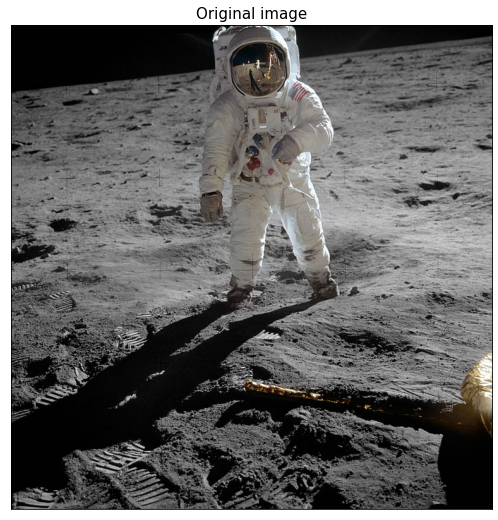

In [90]:
from skimage import io

image = cv2.cvtColor(io.imread('https://upload.wikimedia.org/wikipedia/commons/thumb/9/98/Aldrin_Apollo_11_original.jpg/763px-Aldrin_Apollo_11_original.jpg'), cv2.COLOR_RGB2BGR)
plotting([image], ['Original image'])

#### 6.1.2 Stage 1: Blurring an image
Like already explained we cannot just blur the image with a simple gaussian blur or similar filter to get a convincing bokeh effect. The characteristic out of focus blur generated by the camera system is much more complex.  
One main characteristic of this blur is that the blur strength is dependent on the depth of field of the scene. The further away the object, the blurrier it is.  
Recreating the depth of an image after the shot was taken is pretty much impossible with conventional image processing methods. Specific cameras, called stereo cameras, produce a map of depth next to the original image, but our approach is to calculate the needed effect by the image itself.  
There are projects like MegaDepth that try to emulate such depth map through machine learning. Projects with the same goal as ours like PyNET-Bokeh is making use of this and gets a very convincing Bokeh effect like that. We tried to follow that approach and replicate similar, but the needed dataset was not uploaded yet and creating one ourselves would have cost too much time and the PyNET-Bokeh project itself is very complex.  
Therefore, we had to put away the idea of recreating such depth map and focus on the other characteristics.  
The other main characteristic of a defocus blur are the blur / Bokeh elements.  
When we look at an image with prominent Bokeh, we can see shaped elements mainly around the highlights. Like already explained those elements can have different shapes with different lenses.  
Therefore, our main goals for recreating such a blur effect were:
  - Creating shaped blur elements
  - Making the blur effect more prominent on the highlights.  

In the following we are showing you how we achieved that.

First we were looking at how to create a shaped like blur effect. As we learned in the lecture blur shape is dependent on the used kernel.  
Looking at commonly used blur filters and their kernels:


In [91]:
!curl -o stars.jpg 'https://images-assets.nasa.gov/image/GSFC_20171208_Archive_e000129/GSFC_20171208_Archive_e000129~orig.jpg'
stars = cv2.imread('stars.jpg')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  370k  100  370k    0     0   462k      0 --:--:-- --:--:-- --:--:--  461k


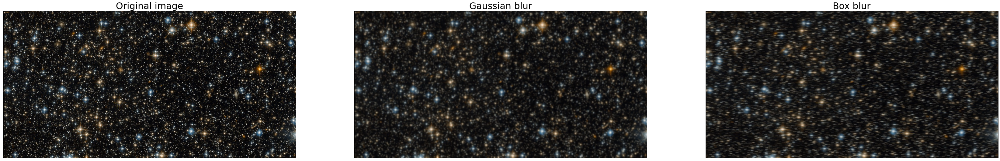

In [92]:
image_gaussian_blur = cv2.GaussianBlur(stars, (11, 11), 0)
image_box_blur = cv2.boxFilter(stars, -1, (11, 1))

plotting([stars, image_gaussian_blur, image_box_blur], ['Original image','Gaussian blur', 'Box blur'], 100)

**Kernels:**  
Gaussian Blur:
\begin{equation}
\frac{1}{16} *\begin{bmatrix}
1 & 2 & 1\\
2 & 4 & 2\\
1 & 2 & 1
\end{bmatrix}
\end{equation}
Box Blur:
\begin{equation}
\frac{1}{9} *\begin{bmatrix}
1 & 1 & 1\\
1 & 1 & 1\\
1 & 1 & 1
\end{bmatrix}
\end{equation}  

**Note:** Pictured kernels were not used in demonstration as a dimension of 3 would be barely visible, instead we used a dimension of 11.

We can see with the box filter that the blur already has a box shaped character. Therefore our idea was to create a round shaped kernel with ones to get a disc shaped blur character.

In [93]:
kernel = np.array([[0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0],
                   [0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0],
                   [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                   [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                   [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
                   [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
                   [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
                   [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                   [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
                   [0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0],
                   [0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0],])
normalization_factor = np.count_nonzero(kernel)
kernel = kernel / normalization_factor

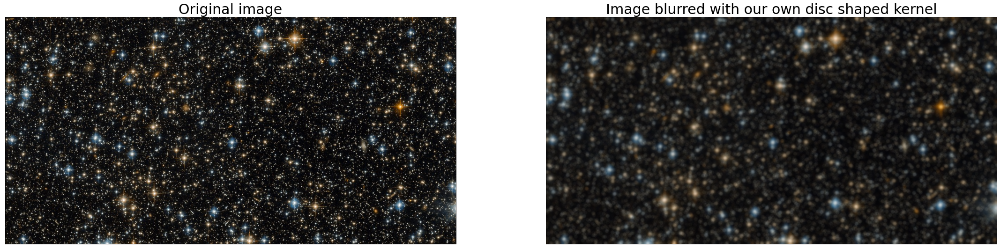

In [94]:
disc_blur = cv2.filter2D(stars, -1, kernel)

plotting([stars, disc_blur], ['Original image', 'Image blurred with our own disc shaped kernel'], 100)

We wanted the blur effect to be adjustable in strength, but creating a kernel for every dimension would have been very time-consuming and also limiting. Therefore, we wanted to create a method to calculate the kernel with given dimensions, but luckily we found out about already available OpenCV functions for that.  
OpenCV comes with multiple structuring elements:

In [95]:
ellipse = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (11, 11))
print(ellipse)
normalization_factor = np.count_nonzero(ellipse)
ellipse = ellipse / normalization_factor

[[0 0 0 0 0 1 0 0 0 0 0]
 [0 0 1 1 1 1 1 1 1 0 0]
 [0 1 1 1 1 1 1 1 1 1 0]
 [1 1 1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1 1 1]
 [1 1 1 1 1 1 1 1 1 1 1]
 [0 1 1 1 1 1 1 1 1 1 0]
 [0 0 1 1 1 1 1 1 1 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]]


In [96]:
cross = cv2.getStructuringElement(cv2.MORPH_CROSS, (11, 11))
print(cross)
normalization_factor = np.count_nonzero(cross)
cross = cross / normalization_factor

[[0 0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]
 [1 1 1 1 1 1 1 1 1 1 1]
 [0 0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]
 [0 0 0 0 0 1 0 0 0 0 0]]


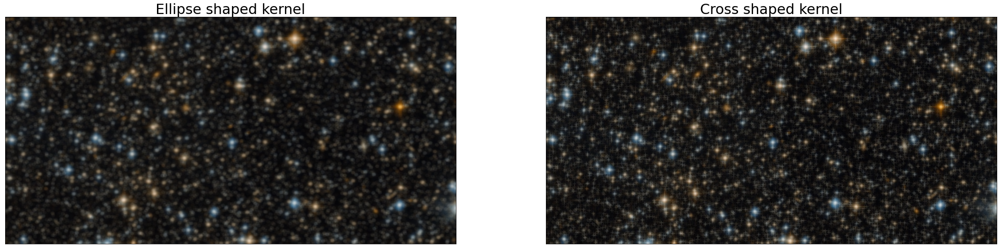

In [97]:
plotting([cv2.filter2D(stars, -1, ellipse), cv2.filter2D(stars, -1, cross)], ['Ellipse shaped kernel', 'Cross shaped kernel'], 100)

We are using the ellipse shaped kernel for our disc shaped blur.  
There is also one for a rectangle shaped kernel, but that is identical to the box filter and not what we were looking for.  
A cross shaped filter is not quite realistic either as there is no lens that creates such bokeh, but as it is an easy kernel to generate, we implemented it anyway.  
To create another realistic bokeh blur we wanted to create a ring shaped kernel, like the one created by catadioptric systems.  
We are doing so by creating an ellipse shaped kernel like above and subtracting a second two dimensions smaller ellipse shaped kernel of it.

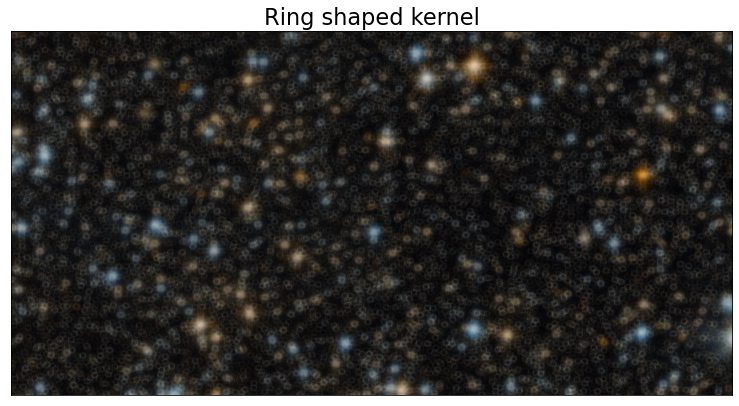

In [98]:
ring = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (11, 11))
kernel_element = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (11 - 2, 11 - 2))
kernel_element = np.r_[[np.zeros(11 - 2)], kernel_element, [np.zeros(11 - 2)]]
kernel_element = np.c_[np.zeros(11), kernel_element, np.zeros(11)]
ring = ring - kernel_element
normalization_factor = np.count_nonzero(ring)
ring = ring / normalization_factor

plotting([cv2.filter2D(stars, -1, ring)], ['Ring shaped kernel'], 75)

**Complete code for further use:**



In [99]:
def bokeh(image, style, dim):
    g_one = 0.4545
    g_two = 2.2

    gam = adjust_gamma(image, gamma=g_one)
    bok = defocus_blur(gam, style, dim)
    bok = adjust_gamma(bok.astype(np.uint8), gamma=g_two)
    blur = defocus_blur(image, style, dim)
    final = np.asarray(np.maximum(bok, blur), dtype='uint8')
    cv2.waitKey(0)

    return final


def defocus_blur(img, style, dim):
    if style == 0:
        kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (dim, dim))
    elif style == 1:
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (dim, dim))
        kernel_element = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (dim - 2, dim - 2))
        kernel_element = np.r_[[np.zeros(dim - 2)], kernel_element, [np.zeros(dim - 2)]]
        kernel_element = np.c_[np.zeros(dim), kernel_element, np.zeros(dim)]
        kernel = kernel - kernel_element
    else:
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (dim, dim))

    normalization_factor = np.count_nonzero(kernel)
    kernel = kernel / normalization_factor

    return cv2.filter2D(img, -1, kernel)

Like that we can create similar blur shapes like seen in real defocus blur, but the blur effect is still effecting dark parts equally to the brighter parts.
That was the next thing we were facing and managed to change that by manipulating the gamma value of the image within the blurring process.  
This process is called gamma manipulation and is used to getting the parts of the image, that should get the shaped blur elements, to stick out more from the rest of the picture. 

In the diagram below, you can see how the process of gamma correction is done.

**Gamma correction process**

<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/gamma/gamma.png" width="400" border=1 />

First, we import the image that is about to be manipulated. 
Next, we have to create a look-up table (LUT) which maps each pixel of the image to its corresponding gamma value. After that we use cv2.LUT(image, lut) to apply these changed values to the image. 






In [100]:
!curl -o tree.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/gamma/image.png'
tree = cv2.imread('tree.jpg')

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  181k  100  181k    0     0   940k      0 --:--:-- --:--:-- --:--:--  944k


In [101]:
def adjust_gamma(image, gamma):
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255
                      for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(image, table)


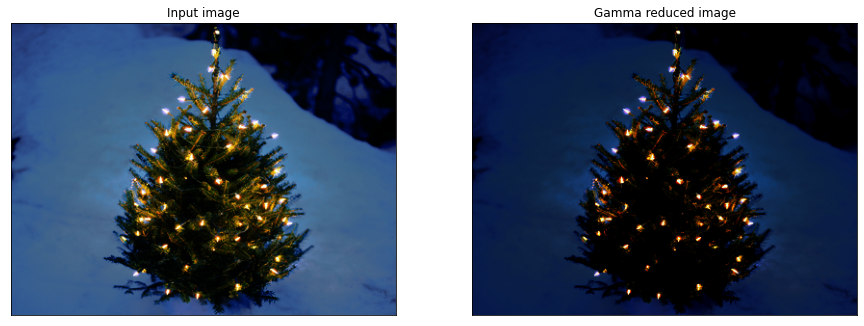

In [102]:
tree_gamma = adjust_gamma(tree, 0.4545)
plotting([tree, tree_gamma], ['Input image', 'Gamma reduced image'], 40)

After that we blur the gamma corrected image to create our blur shapes. Additionally, we also will blur the image with the original gamma values, to keep the original colours. The original image also gets its own LUT.



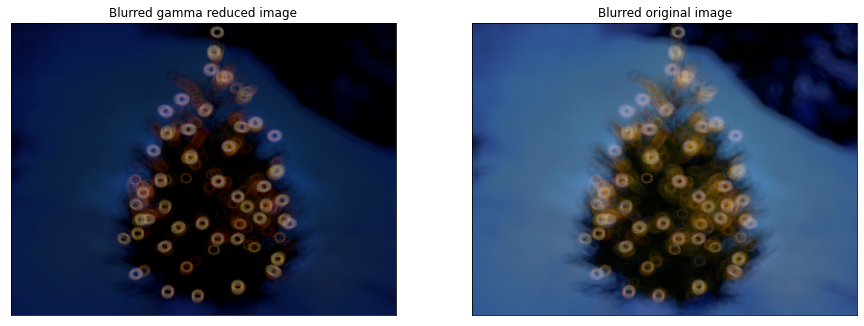

In [103]:
blur_style = 1
blur_dim = 11

tree_gamma_blurred = bokeh(tree_gamma, blur_style, blur_dim)
tree_blurred = bokeh(tree, blur_style, blur_dim)
plotting([tree_gamma_blurred, tree_blurred], ['Blurred gamma reduced image', 'Blurred original image'], 40)
tree_gamma_blurred = adjust_gamma(tree_gamma_blurred, 2.2)

At last, we have to combine both the blurred images with the numpy.maximum function, to get a picture with both the brighter blur shapes and the original colours.


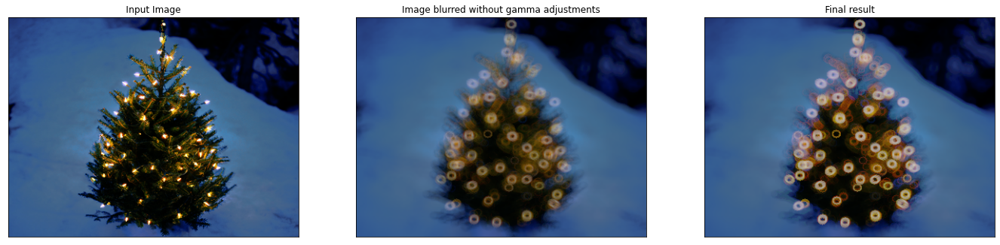

In [104]:
tree_final = np.asarray(np.maximum(tree_gamma_blurred, tree_blurred), dtype='uint8')
plotting([tree, tree_blurred, tree_final], ['Input Image', 'Image blurred without gamma adjustments', 'Final result'], 40)

Next we apply our blur effect on our main image.

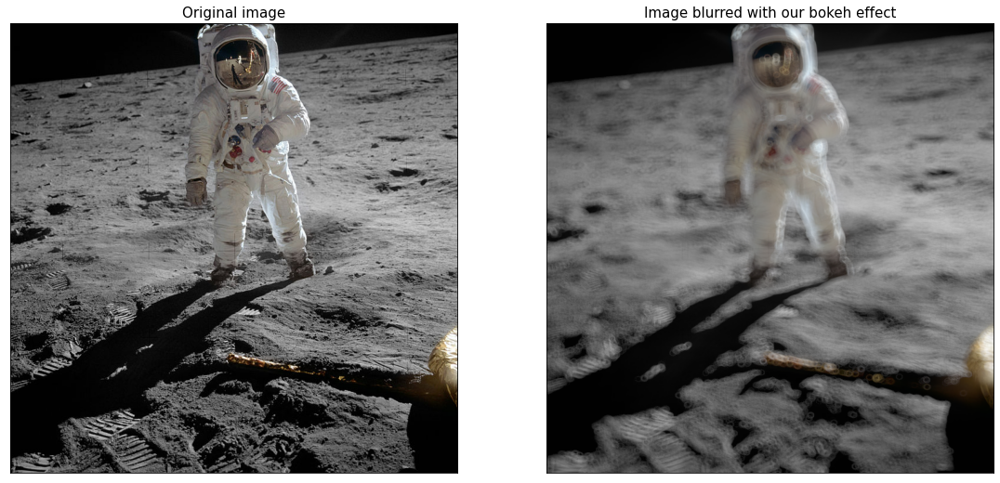

In [105]:
plotting([image, bokeh(image, blur_style, blur_dim)], ['Original image', 'Image blurred with our bokeh effect'])
blur_dim = 7

The shaped bokeh elements are now very well visible in the highlights part.

#### 6.1.3 Stage 2: Saliency detection

The goal in this stage is to get the main subject of the given image and filter it out and to blur the rest of the image.  

Our first approaches were getting the main subject by analysing the focus point with common edge detection methods like Canny or high-pass filtering.  
The idea behind that is that when the photo was taken the main subject had to be in focus and therefore should be the sharpest part of the image. So in theory looking for the highest local contrast / edges in the image should get us the main subject of the photo.


**Canny edge detection**

In [106]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

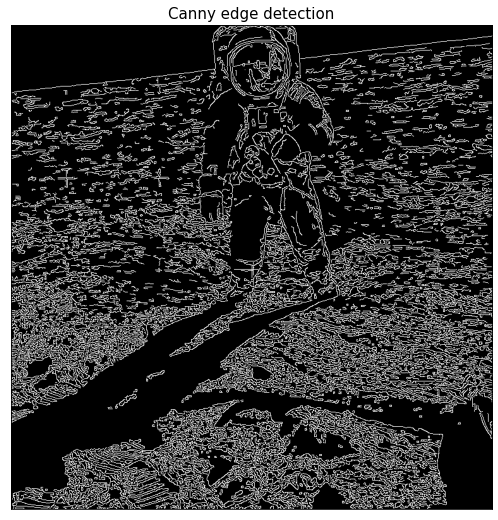

In [107]:
def auto_canny(image, sigma=0.33):
	v = np.median(image)
	lower = int(max(0, (1.0 - sigma) * v))
	upper = int(min(255, (1.0 + sigma) * v))
	edged = cv2.Canny(image, lower, upper)
	return edged
blurred = cv2.GaussianBlur(gray, (3, 3), 0)
edges_canny = auto_canny(blurred)
plotting([edges_canny], ['Canny edge detection'])

**High pass filtering**

<function matplotlib.pyplot.show>

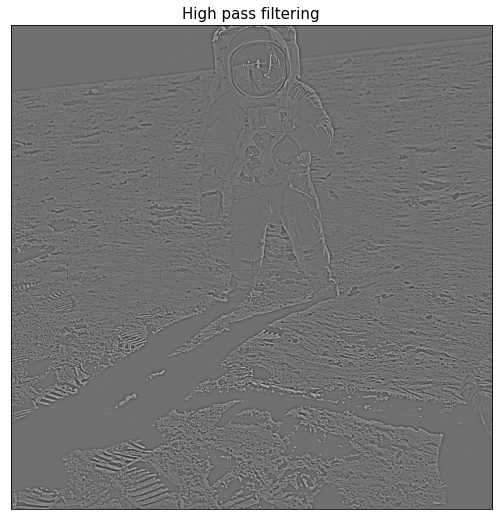

In [108]:
gray = np.asarray(gray, dtype=float)
lowpass = np.asarray(cv2.GaussianBlur(gray, (11, 11), 0), dtype=float)
gauss_highpass = gray - lowpass
plt.figure(figsize=(50,50))
plt.gray()
plt.subplot(1,5,1), plt.imshow(gauss_highpass)
plt.title('High pass filtering', fontsize=15)
plt.xticks([]),plt.yticks([])
plt.show

Looking at the results of Canny edge detection and high pass filtering we can indeed see some of the wanted edges, but it is showing much more edges, that we do not need.  
Furthermore, we are dependent of a threshold that we have to set manually to get the optimal result. Like that we would not be able to generate an automatic result.  

Soon after we were stumbling over concepts of saliency detection with a machine learning approaches. By looking at [this project](http://rahulrav.com/blog/bokehlicious.html) we found out about R-CNN, that comes with torchvision.

##### 6.1.3.1 R-CNN
R-CNN was the first detection algorithm that we were able to use in our project. The predicted mask is acceptable for some instances.

**rcnn.py** (edited to be executable):

Downloading: "https://download.pytorch.org/models/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth" to /root/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth


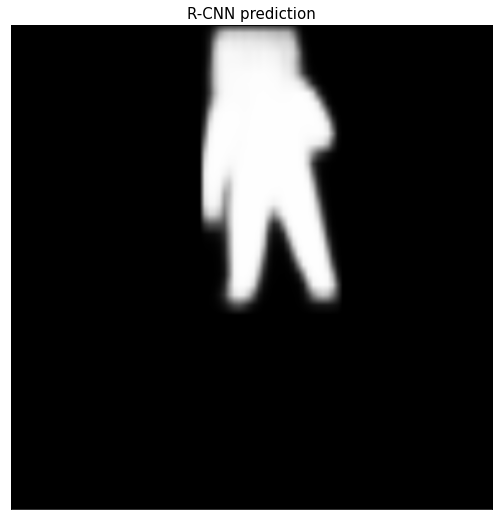

In [109]:
import torch
import torchvision


def rcnn(image):
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)
    model.eval()

    channels_first = np.moveaxis(image / 255., 2, 0)

    channels_first = torch.from_numpy(channels_first).float()

    prediction = model([channels_first])[0]
    image_masks = prediction['masks'].detach().numpy()

    return np.asarray(image_masks[0][0] * 255, dtype='uint8')


mask_rcnn = rcnn(image)
plotting([mask_rcnn], ['R-CNN prediction'])

As we can see in the result this method returns a mask that is a prediction of the main subject of the image.

R-CNNs predictions are most of the time useable, but are often struggling with multiple subjects in an image and is often leaving some space to the subjects edges.  

Therefore we were looking further for some alternatives and found another saliency detection concept called PoolNET after looking at last years project '[Make It Aesthetic!](https://github.com/uol-mediaprocessing-201920/group-projects-make-it-aesthetic)'.



##### 6.1.3.2 PoolNET
Using PoolNET is identical to using R-CNN. We pass over our image and get a prediction mask of the main subject. The concept behind it and the resulting predictions on the other hand differ from R-CNN.

This is an external model that needs to be loaded into our project seperately like explained in the installation section.  

To make it executable in here we have to load it into this notebook as well.


In [110]:
%%bash
curl -J -O  "https://cloudstorage.elearning.uni-oldenburg.de/s/8Ye7T4JeBHn5MEz/download"
unzip -q poolnet.zip

curl: Saved to filename 'poolnet.zip'


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  186M  100  186M    0     0  15.7M      0  0:00:11  0:00:11 --:--:-- 19.1M


Now we can use PoolNET for our mask prediction, but running the prediction without any preprocessing of the image takes a very long time. The computing time depends on the size of the image. We have been canceling the prediction for a 10 megapixel image after 5 minutes computation.  
Therefore we decided to scale down the image to maximal 500 pixel on the longer side for the prediction.  
After doing so we get a smaller shaped mask array than the original image and therefore have to resize it back to the original shape to make further calculations possible.  

**pool.py** (edited to be executable):

In [111]:
def pool_predict(img, use_scale):
    image = np.copy(img)
    if use_scale == 0:
        height, width = image.shape[:2]
        if height > 500 or width > 500:
            image = compress_image(img)

    image_numpy = np.array(image, dtype=np.float32)
    image_numpy = image_numpy.transpose((2, 0, 1))
    image_tensor = torch.Tensor(image_numpy)
    image_tensor = torch.autograd.Variable(image_tensor.unsqueeze(0))

    poolnet = torch.load("poolnet.pth")

    prediction = poolnet(image_tensor)

    saliency_map = np.squeeze(torch.sigmoid(prediction).cpu().data.numpy())
    saliency_map_scaled = saliency_map * 255
    return np.asarray(cv2.resize(saliency_map_scaled, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_AREA), dtype='uint8')


def compress_image(img):
    height, width = img.shape[:2]

    if width > height:
        scale_percent = int(500 * 100 / width)
    else:
        scale_percent = int(500 * 100 / height)

    width = int(img.shape[1] * scale_percent / 100)
    height = int(img.shape[0] * scale_percent / 100)
    dim = (width, height)

    resized = cv2.resize(img, dim, interpolation=cv2.INTER_AREA)

    return resized

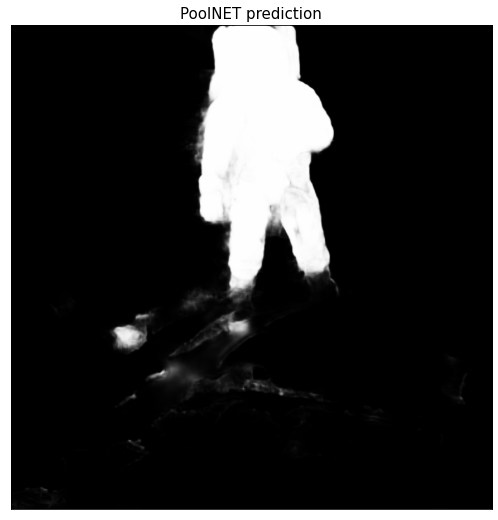

In [112]:
mask_pool = pool_predict(image, True)
plotting([mask_pool], ['PoolNET prediction'])

With scaling down the image beforehand and upscaling after prediction we can reduce computation time for larger images significantly, but also reduce the quality of the resulting mask.

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  134k  100  134k    0     0   753k      0 --:--:-- --:--:-- --:--:--  753k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  119k  100  119k    0     0   526k      0 --:--:-- --:--:-- --:--:--  526k


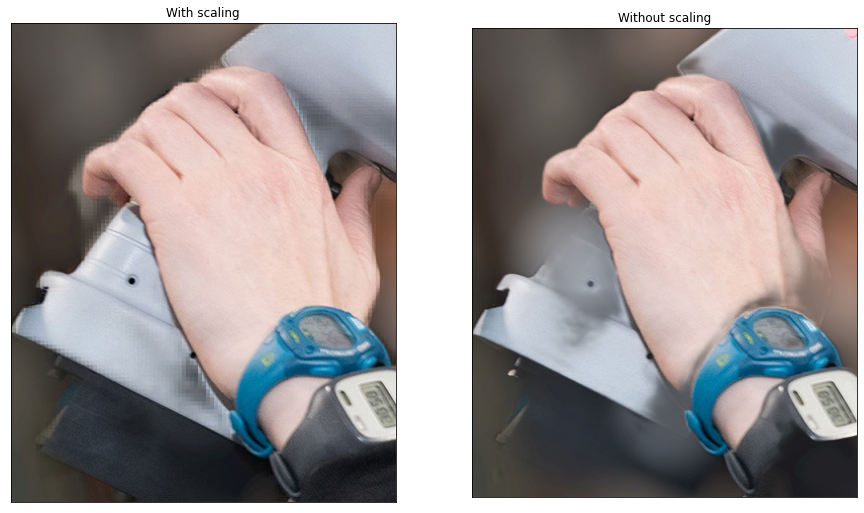

In [113]:
!curl -o scaling-on.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/test_AN.jpeg'
!curl -o scaling-off.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/test_AUS.jpeg'

plotting([cv2.imread('scaling-on.jpg'), cv2.imread('scaling-off.jpg')], ['With scaling', 'Without scaling'], 40)

We cannot recommend running the code above without scaling, because the computing time is very long with larger images.

##### 6.1.3.3 Comparison
Generally speaking PoolNET gives us better results for the most part, but it is also needing much more time to compute.  
R-CNN is    faster than PoolNET.
When there is only one main subject in the image, both results are quite similar most of the time.  
But the crucial downside of R-CNN is that it cannot detect multiple subjects at once. It always tries to reduce it to one subject. So for instance in a group photo R-CNN focus on one person only, whereas PoolNET gives us the wanted result.
This was the main reason we decided to introduce PoolNET as our main solution in our GUI.  
Nonetheless, the user still has the option to switch to R-CNN if wanted. Like that the user has the chance to get another automatic result before editing it manually.  
For a side by side comparison go to the last section with examples.

#### 6.1.4 Stage 3: Masking
At this stage we are making use of the generated mask from the previous stage and put together the image using the original and blurred image.

##### 6.1.4.1 Procedure
First we are inverting the mask. Like this we get a mask for both the subject and the background.  
**Note:** To change the saliency detection method for this demonstration change the commenting in the code down below.

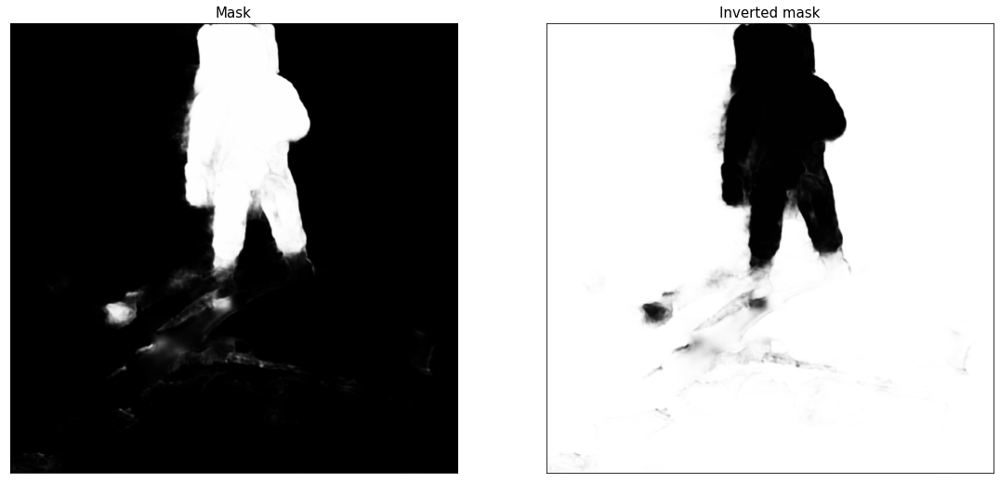

In [114]:
import matplotlib.pyplot as plt

#mask = mask_rcnn
mask = mask_pool
mask_inverted = np.invert(mask)
plotting([mask, mask_inverted], ['Mask', 'Inverted mask'])

Afterwards we are converting both masks from grayscale into BGR color space. This makes it easier to use them for further calculations.

In [115]:
mask = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)
mask_inverted = cv2.cvtColor(mask_inverted, cv2.COLOR_GRAY2BGR)

Now we can use the masks to cut out the subject and background from the original image.  
We are normalizing the mask so it has values reaching from 0 to 1 and multiply both image and mask with each other. After multiplication every black pixel in the mask cancels out the corresponding pixel in the image array or lowers its intensity. Simultaneously every white pixel in the mask copies the corresponding pixel of the image into the resulting output array.  

Calculation example:  

 **Mask**             |  | **Image**        |  | **Output**       |-              
----------------------|------|------------------|------|------------------|-------------------
 \(0, 0, 0\)          | \*   | \(23, 154, 44\)  | =    | \(0, 0, 0\)      | canceled out      
 \(0\.5, 0\.5, 0\.5\) | \*   | \(64, 80, 128\)  | =    | \(32, 40, 64\)   | lowered intensity 
 \(1, 1, 1\)          | \*   | \(87, 142, 100\) | =    | \(87, 142, 100\) | copied            
                      |      |                  |      |                  |                   



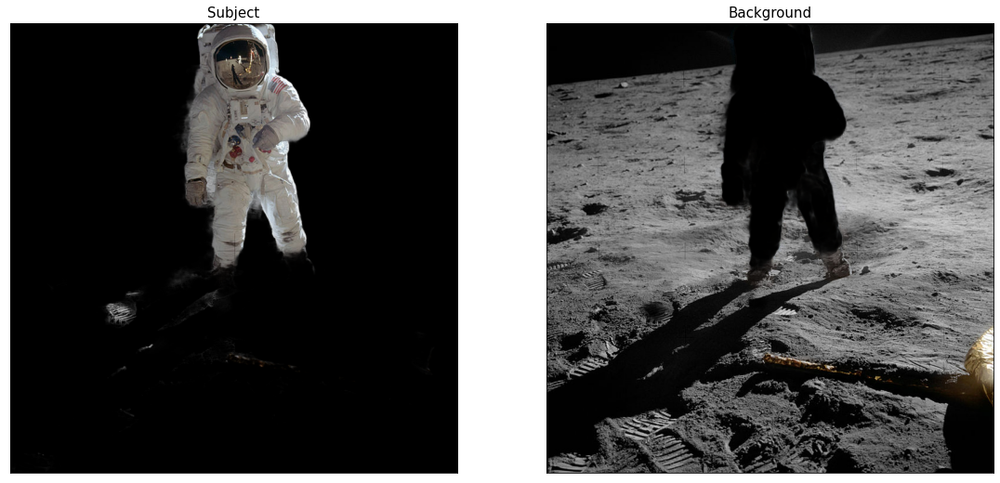

In [116]:
subject = np.asarray(image * (mask / 255), dtype='uint8')
background = np.asarray(image * (mask_inverted / 255), dtype='uint8')

plotting([subject, background], ['Subject', 'Background'])

Next we are blurring the background with our blur effect. We are using a circle shaped bokeh effect with a strength of 10.

In [117]:
background_bokeh = np.asarray(bokeh(background, blur_style, blur_dim), dtype='uint8')

By blurring the background we are introducing color values back into the subject area (and also black into the background area, we are discussing that later on). Therefore we have to multiply the array with the inverted mask once again to get rid of these values.

In [118]:
background_bokeh = np.asarray(background_bokeh * (mask_inverted / 255), dtype='uint8')

Finally, we can add both numpy arrays together. As there are only color values in the background were the subject is black and vice versa, there is no interference between them both.

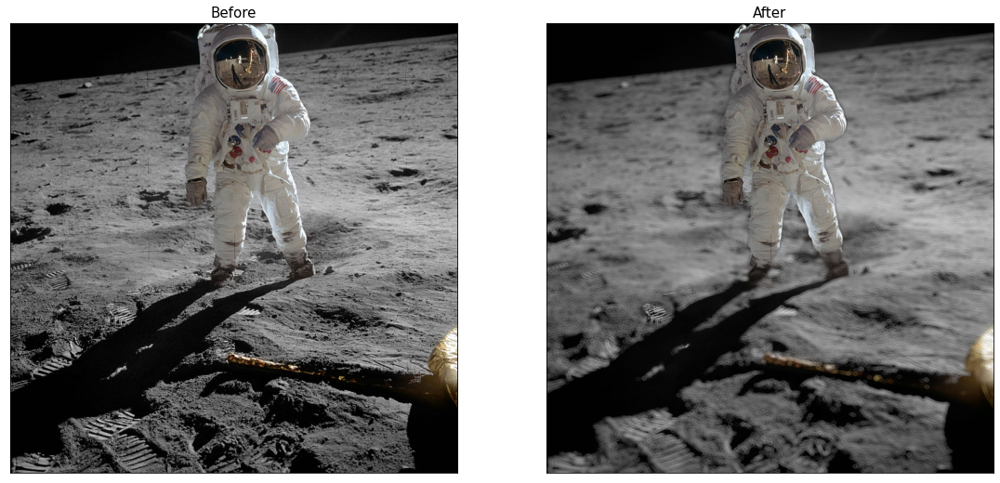

In [119]:
result = subject + background_bokeh

plotting([image, result], ['Before', 'After'])

Like that we get our automatically generated result with a bokeh effect.

Complete code of masking for later use:

In [120]:
def masking(image, mask):
  #mask_inverted = np.invert(mask)
  #mask = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)
  #mask_inverted = cv2.cvtColor(mask_inverted, cv2.COLOR_GRAY2BGR)
  subject = np.asarray(image * (mask / 255), dtype='uint8')
  background = np.asarray(image * (mask_inverted / 255), dtype='uint8')
  background_bokeh = np.asarray(bokeh(background, blur_style, blur_dim), dtype='uint8')
  background_bokeh = np.asarray(background_bokeh * (mask_inverted / 255), dtype='uint8')
  return subject + background_bokeh

##### 6.1.4.2 Haloing effect
When looking closely at our results you can see a haloing effect around the subject edges. Especially in areas where the background is bright.  
We tried to get rid of it but unfortunately have not completely managed to do so.  

Originally we were creating the background out of a multiplication with the image blurred beforehand.





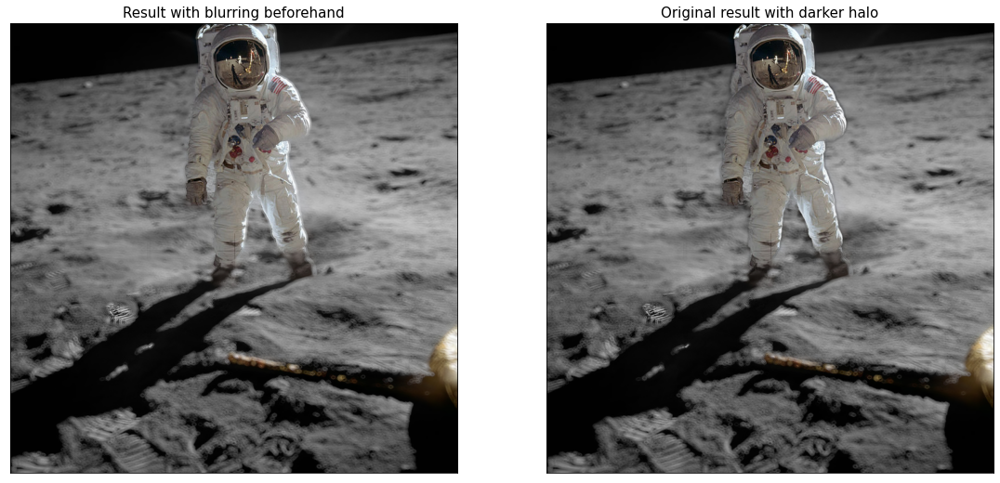

In [121]:
blurred = np.asarray(bokeh(image, blur_style, blur_dim), dtype='uint8')

subject2 = np.asarray(image * (mask / 255), dtype='uint8')
background2 = np.asarray(blurred * (mask_inverted / 255), dtype='uint8')

result2 = subject2 + background2

plotting([result2, result], ['Result with blurring beforehand', 'Original result with darker halo'])

As we are blurring the complete image with this method, parts of the subject get blurred into the background, and create a prominent halo all around the subject.

So we instead tried to eliminate this by blurring the background after the multiplication like explained in the procedure above. Like that we blur black into the backround and we get a dark halo around the subject instead.  
We tried to fix that by converting the background to BGRA and convert the black pixels to an alpha mask, but when applying our blur effect it recognizes the alpha mask as black, so there was no difference.


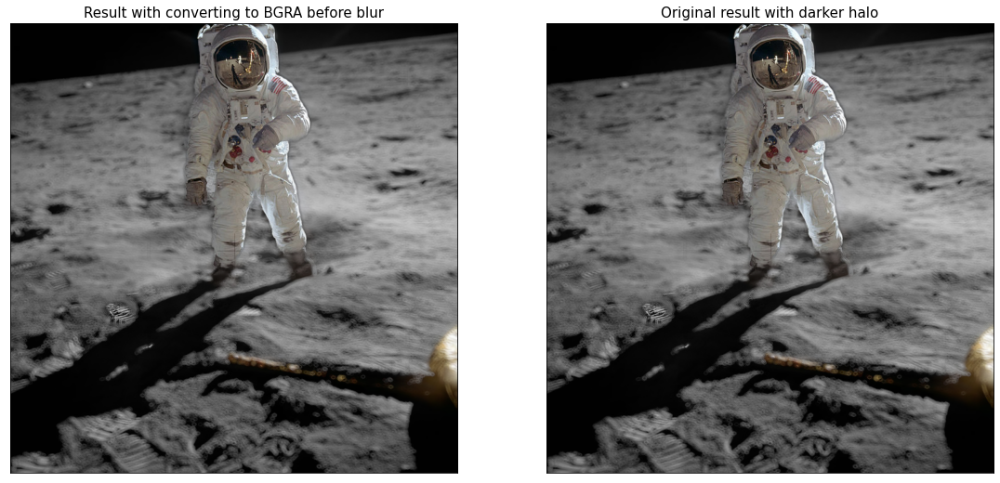

In [122]:
background_bgra = cv2.cvtColor(background, cv2.COLOR_BGR2BGRA)
background_bokeh_bgra = np.asarray(bokeh(background_bgra, blur_style, blur_dim), dtype='uint8')
background_bokeh_bgr = cv2.cvtColor(background_bokeh_bgra, cv2.COLOR_BGRA2BGR)
background_bokeh_bgr = np.asarray(background_bokeh_bgr * (mask_inverted / 255), dtype='uint8')
result_bgr = background_bokeh_bgr + subject

plotting([result_bgr, result], ['Result with converting to BGRA before blur', 'Original result with darker halo'])

Another try of ours was to blur the background like above, but also blur another copy with complete white for the subject, so we can merge them together afterwards.

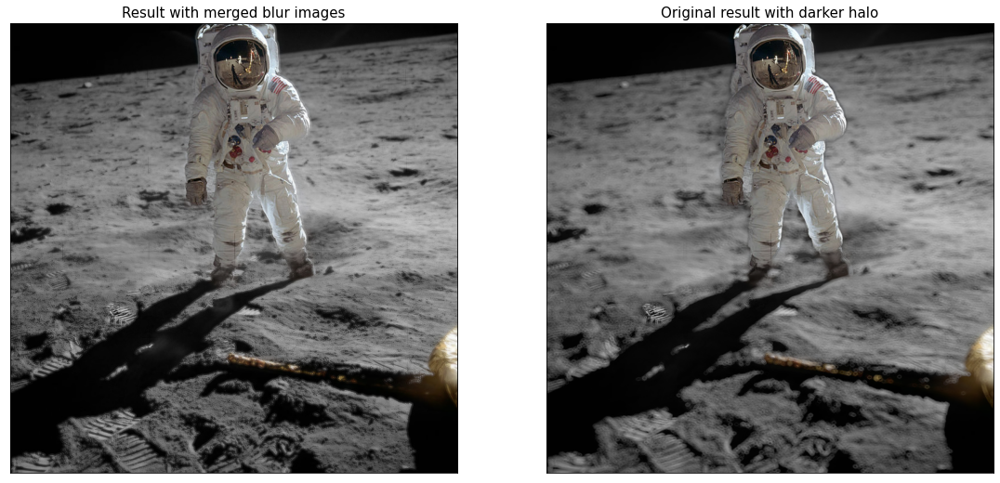

In [123]:
background_white = background + mask
background_white_bokeh = np.asarray(bokeh(background_white, blur_style, blur_dim), dtype='uint8')
background_merged = cv2.addWeighted(background, 0.5, background_white_bokeh, 0.5, 0)
background_merged = np.asarray(background_merged * (mask_inverted / 255), dtype='uint8')
result_merged = background_merged + subject

plotting([result_merged, result], ['Result with merged blur images', 'Original result with darker halo'])

This may work using a normal blur effect, because by merging them together the bright halo eliminates the dark halo, but as we are using a blur effect that effects brighter parts more than darker parts through gamma manipulation during the blurring process, this does not work as intended.  

Our last try was to change our blur effect to convolve just the parts of an image where the mask is black.  

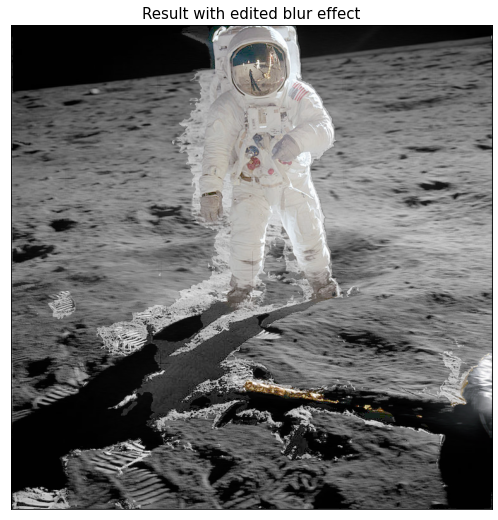

In [124]:
def bokeh_edited(image, style, dim):
  g_one = 0.4545
  g_two = 2.2

  image2 = image.copy()
  gam2 = adjust_gamma(image, gamma=g_one)
  bok2 = image.copy()
  bok2[np.all(mask == [0, 0, 0], -1)] = defocus_blur(gam2[np.all(mask == [0, 0, 0], -1)], style, dim)
  bok2 = adjust_gamma(bok2.astype(np.uint8), gamma=g_two)
  blur2 = image.copy()
  blur2[np.all(mask == [0, 0, 0], -1)] = defocus_blur(image2[np.all(mask == [0, 0, 0], -1)], style, dim)
  final2 = np.asarray(np.maximum(bok2, blur2), dtype='uint8')

  return final2

plotting([bokeh_edited(image, blur_style, blur_dim)], ['Result with edited blur effect'])

Like that the subject area is indeed not effected, but we are getting an unpredicted result with a desaturated background.

Due to time distress we agreed on keeping the darker halo, as black is not as much effected by our blur effect as the brighter values.

##### 6.1.4.3 Result examples
Here we are showing some of our results using this method with a side by side comparison of PoolNET and R-CNN.



In [ ]:
!curl -o result1-before.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/ghettoblaster-1452077_640.jpg'
!curl -o result1-after-pool.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/ghettoblaster-1452077_640-C10-pool.jpg'
!curl -o result1-after-rcnn.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/ghettoblaster-1452077_640-C10-rcnn.jpg'
!curl -o result2-before.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/ball.jpg'
!curl -o result2-after-pool.png 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/ball_pool.png'
!curl -o result2-after-rcnn.png 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/ball_rcnn.png'
!curl -o result3-before.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/apple1.jpg'
!curl -o result3-after-pool.png 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/apple1_pool.png'
!curl -o result3-after-rcnn.png 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/apple1_rcnn.png'
!curl -o result4-before.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/workout-5914643_640.jpg'
!curl -o result4-after-pool.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/workout-5914643_640-Cr-pool.jpg'
!curl -o result4-after-rcnn.jpeg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/workout-5914643_640-Cr-rcnn.jpeg'
!curl -o result5-before.jpg 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/nasa.jpg'
!curl -o result5-after-pool.png 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/nasa_pool.png'
!curl -o result5-after-rcnn.png 'https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/photos/nasa_rcnn.png'


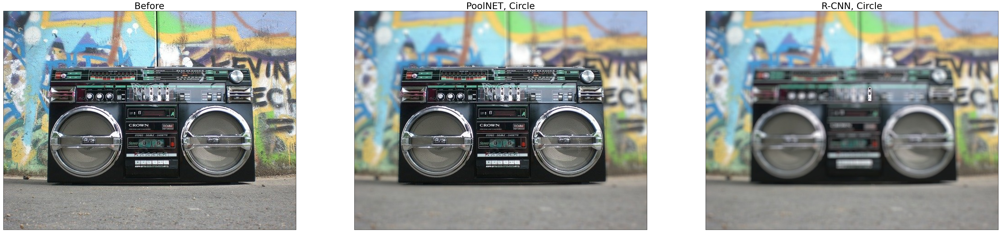

In [126]:
plotting([cv2.imread('result1-before.jpg'), cv2.imread('result1-after-pool.jpg'), cv2.imread('result1-after-rcnn.jpg')], ['Before', 'PoolNET, Circle', 'R-CNN, Circle'], 100)

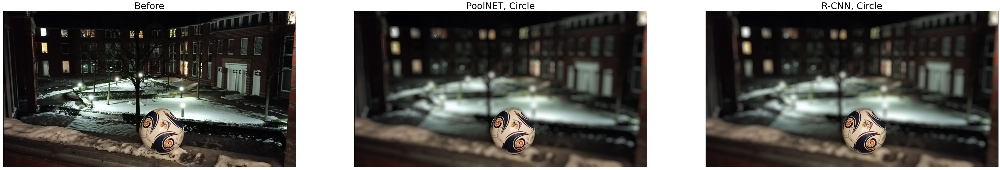

In [127]:
plotting([cv2.imread('result2-before.jpg'), cv2.imread('result2-after-pool.png'), cv2.imread('result2-after-rcnn.png')], ['Before', 'PoolNET, Circle', 'R-CNN, Circle'], 100)

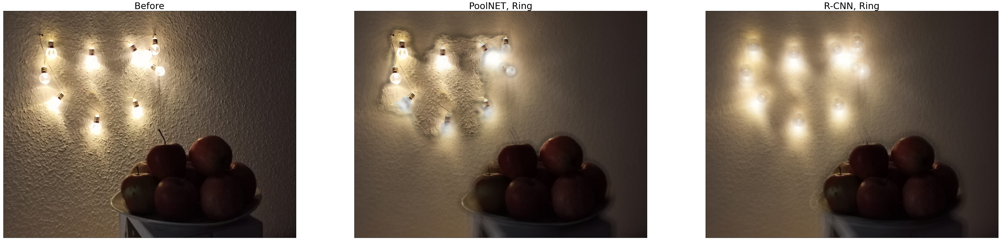

In [128]:
plotting([cv2.imread('result3-before.jpg'), cv2.imread('result3-after-pool.png'), cv2.imread('result3-after-rcnn.png')], ['Before', 'PoolNET, Ring', 'R-CNN, Ring'], 100)

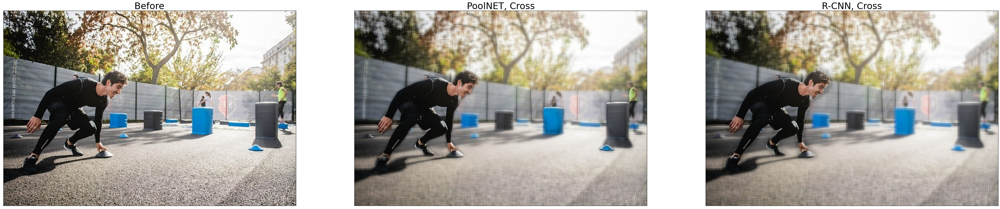

In [129]:
plotting([cv2.imread('result4-before.jpg'), cv2.imread('result4-after-pool.jpg'), cv2.imread('result4-after-rcnn.jpeg')], ['Before', 'PoolNET, Cross', 'R-CNN, Cross'], 100)

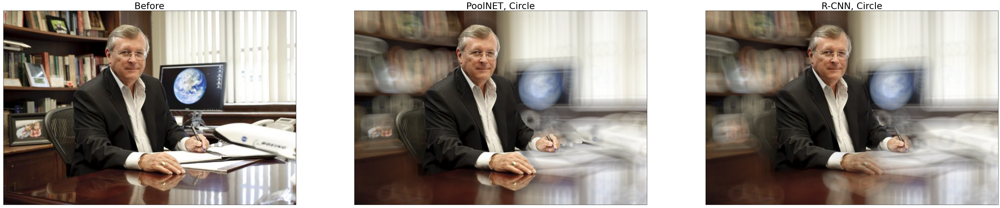

In [130]:
plotting([cv2.imread('result5-before.jpg'), cv2.imread('result5-after-pool.png'), cv2.imread('result5-after-rcnn.png')], ['Before', 'PoolNET, Circle', 'R-CNN, Circle'], 100)

#### 6.1.5 (Optional) Stage 4: Segmentation / SLIC
Most of the time we get good results with the automatic saliency detection method, but there always can be situations were the results differ from what the user expected or wanted.  
Therefore we were looking for a method to fine tune the resulting image to one owns preferations.  
We are achieving that by segmenting the image into areas and let the user choose what area needs to be reedited. To segment the picture we are using a method called SLIC algorithm.  
The SLIC algorithm adapt its superpixels to the edges in the image. Also we let the user choose how much the image is segmented, so he can fine tune detailed areas in the image.  

There are multiple versions of the SLIC algorithm available for Python. One of them is coming with OpenCV itself and another one is available from the scikit-image/skimage library.    


In [131]:
def slic_cv(image):
  image_blurred = cv2.GaussianBlur(image, (5, 5), 0)
  cv_slic = cv2.ximgproc.createSuperpixelSLIC(image=image_blurred, algorithm=cv2.ximgproc.SLICO, region_size=75)
  cv_slic.iterate(5)
  mask_slic_cv = cv_slic.getLabelContourMask()
  mask_inv_slic_cv = cv2.bitwise_not(mask_slic_cv)
  img_slic_cv = cv2.bitwise_and(image, image, mask=mask_inv_slic_cv)
  return img_slic_cv

In [132]:
from skimage.segmentation import mark_boundaries
from skimage.segmentation import slic

def slic_skimage(image):
  segments = slic(image, n_segments=100, sigma=5)
  return np.asarray(mark_boundaries(image, segments) * 255, dtype='uint8')


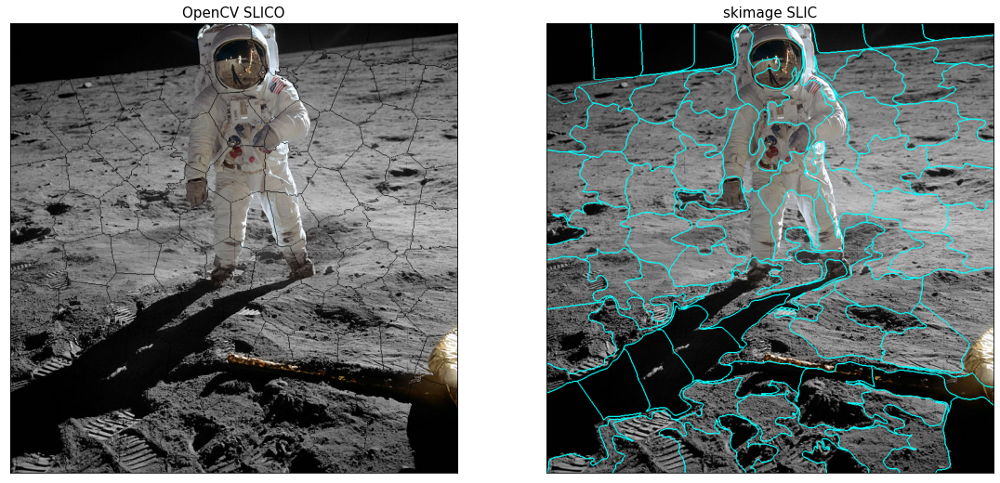

In [133]:
plotting([slic_cv(image), slic_skimage(image)], ['OpenCV SLICO', 'skimage SLIC'])

Comparing those two versions we find that the skimage SLIC version is adapting to edges in the image much better and is also easier to handle in coding process.  
Therefore we decided to use the skimage version for our implementation. 

After reading through the [documentation](https://scikit-image.org/docs/dev/api/skimage.segmentation.html) of skimages SLIC algorithm and finding a [blog post](https://www.pyimagesearch.com/2014/12/29/accessing-individual-superpixel-segmentations-python/) with good instructions on how to use it properly, we were ready to implement it ourselves.
 
When looking at the generated segments numpy array it has the same shape of the original image and for every pixel of the image a corresponding superpixels index.
Like that we can later access pixels in the original image by its superpixel index saved in the segments array.

In [134]:
segments = slic(image, 100, sigma=5)

image_height, image_width, _ = image.shape
segments_height, segments_width = segments.shape

print('Image: ' + str(image_width) + ', ' + str(image_height))
print('Segments: ' + str(segments_width) + ', ' + str(segments_height) + '\n')

with np.printoptions(edgeitems=10):
  print(segments)

Image: 763, 768
Segments: 763, 768

[[ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 [ 0  0  0  0  0  0  0  0  0  0 ...  8  8  8  8  8  8  8  8  8  8]
 ...
 [71 71 71 71 79 79 79 79 79 79 ... 74 74 74 74 74 74 74 74 74 74]
 [71 71 71 71 79 79 79 79 79 79 ... 74 74 74 74 74 74 74 74 74 74]
 [71 71 71 79 79 79 79 79 79 79 ... 74 74 74 74 74 74 74 74 74 74]
 [71 71 71 79 79 79 79 79 79 79 ... 74 74 74 74 74 74 74 74 74 74]
 [71 71 71 79 79 79 7





First we have to generate an image that shows the segmentation of the image, but with taking into account that the given image could be already edited and parts of it being blurred. A segmentation of an already blurred image would not make much sense, because the SLIC algorithm would not detect the edges in the blurred areas and it would be difficult to recover those areas as wanted.  
Therefore we need to pass over the original/unedited image next to the edited image, so we can generate the segments out of the original image, but lay the marked boundaries over the edited image. Also we need the GUI input for the amount of segments.

In [135]:
def show_segmentation(image, original, num_segments):
    segments = slic(original, n_segments=num_segments, sigma=5)
    result = np.asarray(mark_boundaries(image, segments) * 255, dtype='uint8')
    return result

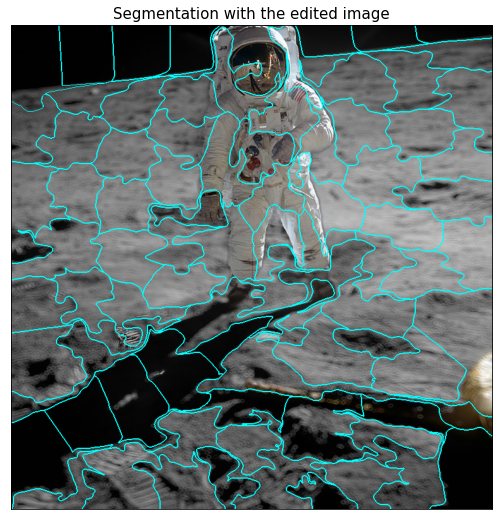

In [136]:
plotting([show_segmentation(result, image, 100)], ['Segmentation with the edited image'])

Now the user can select what segment should be either blurred or unblurred.  
For that we need the edited image shown in the GUI, the original image, the coordinates of the user input and the boolean value whether the segment should be blurred.  
First we are creating a completely blurred image of the original image if the boolean value is true and save it into the variable background. If the boolean value is false the original image gets saved.
Afterwards we are generating the segments out of the original image with the user input of segment numbers once again.
We are determining whether the has clicked on a segment or selected multiple.  
If the user just clicked on a segment, the values of the background corresponding to the superpixel index get copied into the image array with the same correspondence and the image gets returned instantly.  
If the user has selected multiple segments on the other hand, we are looking at what segments the user selected in the GUI by iterating over the range of input coordinates and save every segment value into an array.  
We are reducing that array afterwards by deleting every duplicates.  
Now we iterate through those selected superpixels and copy values of the background corresponding to the superpixel index into the the image array also corresponding to the superpixel index.  
Like that the selected superpixels get either blurred or unblurred and the edited image gets returned. 

In [137]:
def edit_segment(image, original, num_segments, x_start, x_end, y_start, y_end, do_blur, blur_style, blur_dim):
    if do_blur:
        background = blur.bokeh(original, blur_style, blur_dim)
    else:
        background = original

    segments = slic(original, n_segments=num_segments, sigma=5)

    if x_start == x_end and y_start == y_end:
        image[segments == segments[y_start][x_start]] = background[segments == segments[y_start][x_start]]
        return image

    selected_segments = []
    for row in range(min(y_start, y_end), max(y_start, y_end)):
        for column in range(min(x_start, x_end), max(x_start, x_end)):
            selected_segments.append(segments[row][column])
    for (i, segVal) in enumerate(np.unique(selected_segments)):
        image[segments == segVal] = background[segments == segVal]
    return image

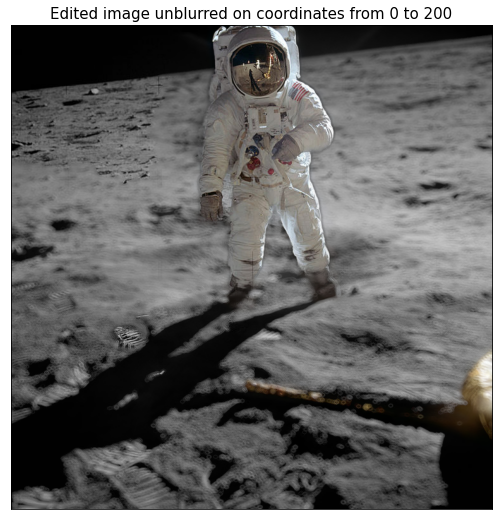

In [138]:
plotting([edit_segment(result, image, 100, 0, 200, 0, 200, False, 1, 11)], ['Edited image unblurred on coordinates from 0 to 200'])

Originally we thought of this as being an option to reedit the automatically generated result, but you can also completely manually edit the image with this method.

###6.2 Graphical user interface

**The code fragments in this section are not executable because Google Colab does not have a display, which is needed to support the TK interface. Please download the project from the repository to use the GUI.**

The graphical user interface (GUI) we created for our project was developed with the GUI Toolkit [Tk interface](https://docs.python.org/3/library/tk.html). Tk interface is a standard library of python and can be integrated without additional installations. We also use the Python image library (PIL), also known as Pillow and openCV, to integrate images in our project and being able to edit them. The libraries are integrated into the project with the following commands.

**Import Tk interface and Pillow** 

In [ ]:
from tkinter import *
from tkinter import filedialog
from tkinter.ttk import Progressbar, Separator
import tkinter.font as font

from PIL import Image, ImageTk

import cv2

Additionally, we use the Queue class from the module queue, to pass the processed image from the ImageProcessing_Thread, to the GUI. The import of numpy is also used to manage arrays. The import of the os library is used to define paths for the images to load and save to. At last, the time module is needed for threading.

**Import Queue and Standard library**

In [ ]:
from queue import Queue
import numpy
import os
import time

####6.2.1 Window composition
To use a graphical user interface in python we have to create a base window (root). We set the icon in the menu header and task bar to a camera icon. After that we set the geometry of the window to 1.5 times the width and height of the user’s screen. The root window will then be divided into four sub windows.

The main window (main_frame) is used to show the image that will be provided with the bokeh effect and is chosen by the user. The editing on the image is viewable in real time.

The Modi window (tool_frame) is used to let the user change the processing modes. The program has two modes. First the auto mode, which find’s edges automatically. Then there is the focus mode, which uses image segmentation to let the user choose the edges manually.

The Bokeh window (effect_frame) is used to list all implemented effects and its properties. A user can use them to edit the chosen image and create the bokeh effect with either a circle, ring or cross effect. The window also provides a slider to change the strength of the blur.

The info window (info_frame) shows information about the program and the loaded image.

**Window initialization**

In [ ]:
root = Tk()
root.iconbitmap('images/camera.ico')
root.title("Bokeh Effekt")
root.config(background="#99aab5")

win_w = root.winfo_screenwidth()
win_h = root.winfo_screenheight()
root.geometry('%sx%s' % (int(win_w/1.5), int(win_h/1.5)))

info_frame = Frame(root, background="#23272a")
info_frame.pack(side=BOTTOM, fill=BOTH)

tool_frame = Frame(root, background="#2c2f33")
tool_frame.pack(side=LEFT, fill=BOTH)

main_frame = Frame(root, background="#3a3e43")
main_frame.pack(side=LEFT, fill=BOTH, expand=True)

effect_frame = Frame(root, background="#2c2f33")
effect_frame.pack(side=LEFT, fill=BOTH)

The figure below shows the GUI, after you open an image.

<img src="https://raw.githubusercontent.com/uol-mediaprocessing-202021/medienverarbeitung-c-bokeh-effect/photos/gui/gui_start.PNG" width="600" border=1 />

####6.2.2 Main Window
The main window contains the image that the user wants to edit. The Image (img) is stored in a canvas called panel. The shown image is always up to date, so when it is processed with an algorithm, the result shows immediately after the algorithm is completed. The canvas is outlined with a white border, to make the image more diverse from the background.

**Create a canvas**

In [ ]:
panel = Canvas(main_frame)
panel.img = img

To load a picture into the canvas, you choose "Öffnen..." under the menu "Datei" in the Header of the program. Doing this will call the method "def open_image():", which will generate the image path, load it into a Pillow Image and then store it into the canvas. After an Image was loaded the submenu "Speichern unter..." becomes available, to save the opened image.

**Function to open an Image**

In [ ]:
def open_image():

    x = filedialog.askopenfilename(title='Bild öffnen')

    if x != '':
        img = Image.open(x)

        img = ImageTk.PhotoImage(img)

        panel.config(width=img.width(), height=img.height())
        panel.create_image(0, 0, image=img, anchor=NW)
        panel.place(anchor="center", relx=0.5, rely=0.5)

        info_label.config(text="Datei: " + x + " | " + "Size: " + str(ori_img.height()) + ' x ' + str(ori_img.width()))

        file_menu.entryconfig("Speichern unter ...", state="normal")

Saving of images is implemented by the method 'save_image()' in the submenu "Speichern unter...". When a user wants to save their image, they will be asked where the image should be saved on the device. Furthermore, the desired image format can be selected before the image is saved. The image can be saved into a .png or .jpeg file.

**Function to save an Image**

In [ ]:
def save_image():

    y = filedialog.asksaveasfilename(title='Bild speichern unter', filetypes=(
        ("PNG Datei (*.png)", "*.png"),
        ("JPEG Datei (*.jpeg)", "*.jpeg"),
        ("Alle Dateien", "*.*"),
    ), defaultextension=os.path.splitext(x), initialfile=os.path.basename(x))

    cv2.imwrite(y, sec_edit)

####6.2.2.1 Resizing images
If the image size is too big for the main window and would get cut of by its border, an implemented resizing function named "def resize_image(image)" gets called when the image gets loaded or updated. The scale factor is 0.7 of the main window heights (max_h). 

Before we can scale the window, we first have to calculate its aspect ratio. Then we use the ratio and max_h to calculate the new image width (new_w).

The image scaling is just for the displaying on the canvas. The real image that is going to be processed with the bokeh effect still have its original size.


**Function of resizing**

In [ ]:
def resize_image(image):
    max_w = int(win_w * global_vars.scale_fac)
    max_h = int(win_h * global_vars.scale_fac)

    image_scale = 1

    if (ori_img.width() >= max_w) or (ori_img.height() >= max_h):

        aspect = ori_img.height() / ori_img.width()
        new_w = int(max_h / aspect)

        result = cv2.resize(image, (new_w, max_h))

        image_scale = new_w / ori_img.width()
        return result
    else:
        return image

####6.2.3 Modi Window
The Modi window (tool_frame) is used to let the user change the processing modes. The program has two modes. First the auto mode, which find edges automatically. Then there is the focus mode, which uses image segmentation to let the user choose the edges manually.

The Modi window is on the left side of the program. It is divided into three parts. The first part is used, to revert the Image to its original state. The Second part contains a button for the auto-mode. The last part contains the content for the focus mode.

**Content of Modi window**

In [ ]:
title_label = Label(tool_frame, text="Modi", background="#2c2f33", fg="white", font=title_font)
title_label.pack(pady=35)

revert_label = Label(tool_frame, text="Zurücksetzen", background="#2c2f33", fg="white", font=label_font)
revert_label.pack()

sep = Separator(tool_frame, orient=HORIZONTAL)
sep.pack(padx=5, fill=BOTH)

revert_button = Button(tool_frame, image=noe, background="#2c2f33", borderwidth=0, activebackground="#2c2f33",
                       command=reset_image, state=DISABLED)
revert_button.pack(padx=30, pady=30, fill=BOTH)

auto_label = Label(tool_frame, text="Auto-Modus", background="#2c2f33", fg="white", font=label_font)
auto_label.pack()

sep1 = Separator(tool_frame, orient=HORIZONTAL)
sep1.pack(padx=5, fill=BOTH)

auto_mode = Button(tool_frame, image=auto, background="#2c2f33", borderwidth=0, activebackground="#2c2f33",
                   font=title_font, fg="white", command=blur_image, relief="sunken", height=40, width=40,
                   state=DISABLED)
auto_mode.pack(padx=30, pady=30, fill=BOTH)

focus_label = Label(tool_frame, text="Fokus-Modus", background="#2c2f33", fg="white", font=label_font)
focus_label.pack()

sep2 = Separator(tool_frame, orient=HORIZONTAL)
sep2.pack(padx=5, fill=BOTH)

focus_mode = Button(tool_frame, image=foc, background="#2c2f33", borderwidth=0, activebackground="#2c2f33",
                    font=title_font, fg="white", command=focus_blur, relief="sunken", height=40, width=40,
                    state=DISABLED)
focus_mode.pack(padx=30, pady=20, fill=BOTH)

slider_var = DoubleVar()
slider = Scale(tool_frame, from_=5, to=1000, bg="#2c2f33", bd=3, fg="white", troughcolor="#3a3e43",
               length=80, sliderlength=20, variable=slider_var, resolution=5, highlightbackground="#2c2f33",
               activebackground="#2c2f33")
slider.set(100)
slider.pack(padx=10, pady=20, fill=BOTH)

check_var = BooleanVar()
check_var.set(True)
check = Checkbutton(tool_frame, text="Blur", variable=check_var, bg="#2c2f33", activebackground="#2c2f33",
                    font=label_font, fg="white", selectcolor="#2c2f33")
check.pack(padx=25, pady=20, fill=BOTH)
check.select()

sep3 = Separator(tool_frame, orient=HORIZONTAL)
sep3.pack(padx=5, pady=5, fill=BOTH)

##### 6.2.3.1 Auto-Mode
Pressing the auto_mode button will blur the image with the help of the in the header menu selected method (see paragraph 5.2.3). The process of edge detection is processed on a separate Thread, to boost the performance of the program. After the edge detection and blurring is done, the processed image gets stores in the queue. The function converts the image into a Pillow Image and displays it in the canvas.

**Function of auto mode**

In [ ]:
def blur_image():
    que = Queue()

    try:
        image_thread = func_gui.IPThread(edge_var.get(), x, scale_var.get(), blur_style, blur_dim.get(), que)
        image_thread.start()
    except KeyboardInterrupt:
        print("[Error] unable to start ImageProcessing_Thread")
        time.sleep(1)

    if not que.empty():
        sec_edit = que.get()
        result = Image.fromarray(cv2.cvtColor(sec_edit, cv2.COLOR_BGR2RGB))
        result = resize_image(result)
        img = ImageTk.PhotoImage(result)

    panel.config(width=img.width(), height=img.height())
    panel.create_image(0, 0, image=img, anchor=NW)

    progress.destroy()

##### 6.2.3.2 Focus-Mode
The focus_mode Button activates the image segmentation through the function "def focus_blur()". The Image in the canvas gets segmented by the value on the slider. You can choose between 5 and 1000 segments, with a default value of 100 after you start the program.

After that the user can select the segments, that should be processed by with his mouse. The paragraph 5.2.3.2.1 addresses the functionality of the mouse tracking.

The Check button with the label "Blur", determines if the chosen segments will be blurred (checked) or reverted to the original state (not checked).

**Function of focus mode**

In [ ]:
def focus_blur():

    cv_img = cv2.imread(x)
    seg = slic.show_segmentation(sec_edit, cv_img, slider_var.get())

    result = Image.fromarray(cv2.cvtColor(seg, cv2.COLOR_BGR2RGB).astype(numpy.uint8))
    result = resize_image(result)
    img = ImageTk.PhotoImage(result)

    panel.config(width=img.width(), height=img.height())
    panel.create_image(0, 0, image=img, anchor=NW)

    rect_id = panel.create_rectangle(y_start, x_start, y_start, x_start, dash=(20, 20), fill='', outline='white')

    panel.bind('<Button-1>', get_mouse_posn)
    panel.bind('<B1-Motion>', update_sel_rect)
    panel.bind('<ButtonRelease-1>', blur_area)

###### 6.2.3.2.1 Mouse Tracking
The user has two possibilities of choosing segments in the focus mode. First, he can click a single segment, to make little changes to the image. For example, you can use it, to correct minor errors made by the algorithms in the auto mode.

Furthermore, the user can also drag a selection rectangle over the image to choose several segments at ones. After the user let go of the left mouse button, all segments that are in the rectangle, will get processed.

The Mouse tracking is done with the Tk interface event system. The program uses three events. The first one is controlled by clicking the left mouse button ('&lt;Button-1&gt;'). The event saves the coordinates of the cursor in the variables x_start, y_start, x_end, y_end in the function "def get_mouse_posn(event):".

The second event gets triggered by the movement of the mouse ('&lt;B1-Motion&gt;'). Is overrides the x_end, y_end variables and draws the rectangle on top of the canvas image.

The last event triggers when the left mouse button gets released ('&lt;ButtonRelease-1&gt;'). The function "def blur_area(event):" uses the coordinates from the other events and calls the "edit_segment" function from slic.py. The processed image gets stores into the canvas. At last, the drawn rectangle and the events gets deleted, to give the user the option, to do the next segmentation.


**Events of mouse tracking**

In [ ]:
def get_mouse_posn(event):
    x_start, y_start = event.x, event.y
    x_end, y_end = event.x, event.y

def update_sel_rect(event):
    x_end, y_end = event.x, event.y
    panel.coords(rect_id, x_start, y_start, x_end, y_end)

def blur_area(event):
    original_img = cv2.imread(x)

    sec_edit = slic.edit_segment(sec_edit, original_img, slider_var.get(), int(x_start / image_scale),
                                 int(x_end / image_scale), int(y_start / image_scale), int(y_end / image_scale),
                                 check_var.get(), blur_style, blur_dim.get())

    result = Image.fromarray(cv2.cvtColor(sec_edit, cv2.COLOR_BGR2RGB).astype(numpy.uint8))
    result = resize_image(result)
    img = ImageTk.PhotoImage(result)

    panel.config(width=img.width(), height=img.height())
    panel.create_image(0, 0, image=img, anchor=NW)

    panel.delete(rect_id)

    panel.unbind('<Button-1>')
    panel.unbind('<B1-Motion>')
    panel.unbind('<ButtonRelease-1>')

##### 6.2.3.3 Revert
Pressing the revert_button triggers the "def reset_image():" function. The variable ori_img stores the originally loaded image. The function overrides the canvas image with the original one and resizes it if necessary. After that it get stores in the canvas ones again.

**Function to reset the image**

In [ ]:
def reset_image():
    img = ori_img

    if (ori_img.width() >= int(win_w * 0.7)) or \
            (ori_img.height() >= int(win_h * 0.7)):
        img = ori_resize
        img = ImageTk.PhotoImage(img)

    blur_img = blur.bokeh(cv2.imread(x), blur_style, blur_dim.get())
    sec_edit = cv2.imread(x)

    panel.config(width=img.width(), height=img.height())
    panel.create_image(0, 0, image=img, anchor=NW)

#### 6.2.4 Bokeh Window
The Bokeh window (effect_frame) handles the appearance of the blurring. It is separated into two parts. The first part contains three buttons, that will let you choose between the three effect types circle, ring, and cross.

The second part contains a slider that sets the intensity of the blur effect. The user can choose between a value of 5 and 100, that will directly change the dimension of the associated kernel. The standard value is 10.


**Content of Bokeh window**

In [ ]:
effect_label = Label(effect_frame, text="Bokeh", background="#2c2f33", fg="white", font=title_font)
effect_label.pack(pady=35, padx=15)

type_label = Label(effect_frame, text="Effekt-Typ", background="#2c2f33", fg="white", font=label_font)
type_label.pack()

sepr = Separator(effect_frame, orient=HORIZONTAL)
sepr.pack(padx=5, fill=BOTH)

round_button = Button(effect_frame, image=round_i, background="#23272a", borderwidth=0, activebackground="#2c2f33",
                      command=lambda *args: change_blur_style(2), height=40, width=40, relief="sunken")
round_button.pack(padx=30, pady=30, fill=BOTH)

ring_button = Button(effect_frame, image=ring_i, background="#2c2f33", borderwidth=0, activebackground="#2c2f33",
                     command=lambda *args: change_blur_style(1), height=40, width=40, relief="sunken")
ring_button.pack(padx=30, pady=30, fill=BOTH)

cross_button = Button(effect_frame, image=cross_i, background="#2c2f33", borderwidth=0, activebackground="#2c2f33",
                      command=lambda *args: change_blur_style(0), height=40, width=40, relief="sunken")
cross_button.pack(padx=30, pady=30, fill=BOTH)

blur_label = Label(effect_frame, text="Effekt-Stärke", background="#2c2f33", fg="white", font=label_font)
blur_label.pack()

sepr1 = Separator(effect_frame, orient=HORIZONTAL)
sepr1.pack(padx=5, fill=BOTH)

blur_dim = IntVar()
slider = Scale(effect_frame, from_=5, to=25, bg="#2c2f33", bd=3, fg="white", troughcolor="#3a3e43",
               length=80, sliderlength=20, variable=blur_dim, resolution=5, highlightbackground="#2c2f33",
               activebackground="#2c2f33")
slider.set(10)
slider.pack(padx=30, pady=20, fill=BOTH)

sepr2 = Separator(effect_frame, orient=HORIZONTAL)
sepr2.pack(padx=5, fill=BOTH)

Clicking one of the effect type buttons will trigger the function def change_blur_style(value). Every button has its own value to represent it. blur_style = 0 results in the cross effect. blur_style = 1 makes the ring effect and blur_style = 2 gets you the circle effect.

**Change the Blur Style**

In [ ]:
def change_blur_style(value):
    global blur_style, round_button, ring_button, cross_button

    blur_style = value

####6.2.5 Info Window
The info window (info_frame) gives information about the loaded image and the program. The frame is located at the bottom of the program.

The current version of the program is on the left side of the info frame. The right side is empty until you load an image. When an image is loaded, the info frame displays the path to the loaded image, and it sizes width and height. Even when the image gets scaled, the shown size will still be the original one, because that will be the size of the image, when it gets saved.

**Content of info window**

In [ ]:
info_label = Label(info_frame, background="#23272a", fg="white")
info_label.pack(side=RIGHT, padx=2, pady=5)

version_label = Label(info_frame, background="#23272a", text="Version: " + global_vars.version, fg="white")
version_label.pack(side=LEFT, padx=2, pady=5)

#####6.2.5.1 Progress Bar
The info window has another feature. While an image is processed, the version_label will get replaced with a progress bar. The bar will move from left to right as long as the edge detection is in process. After that, the bar will disappear again, and the version label will reappear.

**Creating a progress bar**

In [ ]:
progress = Progressbar(info_frame, orient=HORIZONTAL, length=75, mode='indeterminate')
progress.pack(side=LEFT)
func_gui.bar(progress, info_frame)

###6.2.6 Header Menu
To make the navigation easier for the user and create a slick and pleasant look of the GUI we use menu bars where the user can find all the important and necessary options. The menu has three submenus.

The first submenu is "Datei". It contains buttons for loading and saving the image as described in paragraph 5.2.2. The submenu also contains an entry to close the program.
The next submenu is called "Einstellungen" and contains the settings of the program. Under "Kantenerkennung" the user can choose which algorithm of edge detection the program should use in auto mode. "Maske skalieren" determine if the mask generated while the edge detection is in process, will be scaled or not.
The last submenu named "Hilfe", contains info about the project and will be described below.

**Content of header menu**

In [ ]:
menu = Menu(root)

file_menu = Menu(menu, tearoff=0)
help_menu = Menu(menu, tearoff=0)
setup_menu = Menu(menu, tearoff=0)

edge_menu = Menu(setup_menu, tearoff=0)
scale_menu = Menu(setup_menu, tearoff=0)

file_menu.add_command(label="Öffnen ...", command=open_image)
file_menu.add_command(label="Speichern unter ...", command=save_image, state="disabled")
file_menu.add_separator()
file_menu.add_command(label="Beenden", command=root.quit)
menu.add_cascade(label="Datei", menu=file_menu)

edge_var = IntVar()
edge_menu.add_radiobutton(label="PoolNET", value=0, variable=edge_var)
edge_menu.add_radiobutton(label="R-CNN", value=1, variable=edge_var)
edge_var.set(0)
setup_menu.add_cascade(label="Kantenerkennung", menu=edge_menu)

scale_var = IntVar()
scale_menu.add_radiobutton(label="An", value=0, variable=scale_var)
scale_menu.add_radiobutton(label="Aus", value=1, variable=scale_var)
scale_var.set(0)
setup_menu.add_cascade(label="Maske skalieren", menu=scale_menu)

setup_menu.add_separator()
setup_menu.add_command(label="Einstellungen zurücksetzen", command=reset_setup)
menu.add_cascade(label="Einstellungen", menu=setup_menu)

help_menu.add_command(label="Über das Projekt", command=func_gui.help_about)
help_menu.add_command(label="Colaboratory", command=func_gui.help_colab)
menu.add_cascade(label="Hilfe", menu=help_menu)

root.config(menu=menu)

Clicking an entry in the "Hilfe" submenu will trigger message boxes that will give the user info about a certain topic.

The first entry opens a message box that will give info about the project as shown in the function "def help_about():". The message boy of the second entry contains a link to this Colaboratory project ("def help_colab():".

**Messageboxen**

In [ ]:
def help_about():
    about_text = "\
Projekt: Medienverarbeitung Gruppe C\n\
Carl-von-Ossietzky Universität Oldenburg\n\
Authors: Jona Schrader, Roman Kammer, Malte Trauernicht\n\
Version: 1.0.0"
    messagebox.showinfo(message=about_text, title="Über das Projekt")

def help_colab():
    about_text = "\
Google Colab Dokumentation des Projektes:\n\
\n\
https://colab.research.google.com/drive/1m-M0v0KiQN6P16nb0lSmRQM8Ma6bkRsD"
    messagebox.showinfo(message=about_text, title="Colaboratory")

#7 Difficulties and conclusion


##7.1 Difficulties

One of our difficulties was, like already explained above, the resulting haloing effect after masking. There is most likely a (probably easy) solution for it, but after many attempts we had to move on because of time restraints.

Another major difficulty was the missing depth map. There are other projects like PyNET-Bokeh that have a good approaches for generating one, but as we are greenhorns in regard to Python, media processing and especially machine learning we had to set that aside. 



##7.2 Conclusion
At the beginning of the project, we were quickly able to find different existing projects which helped us immediately to organize our own approach. Before the project really started rolling, we had already many different ideas to segment objects from the background. The more we moved on, the more ideas came in while some were left out and we refined our standpoint constantly integrating new ideas, algorithms, methods etc. to the project. While we tried out all the different approaches and solved the few problems we established more and more a better understanding on which approaches get us the best results. 

The only part that is missing is the machine learning aspect. We used from the start pretrained models which from our standpoint was the right choice and the right direction, because we wanted an algorithm, a product, which is open to a broad and diverse amount of different image settings.

At the time we had the base premise in a great direction (image segmentation, object detection, blur effect), we thought about making a GUI and different features to get more spice to the project. Being able to generate a Bokeh effect is great but our idea in implementing SLIC and the GUI to the project was a nice addition. We now have a product which is not only living up to the project goal which was set but also coming with extra features which complement our project in a very good way.

We know this project is not revolutional, as pretty much every modern smartphone is capable of doing the same in real time, but the approach of integrating special lens profiles is something we have barely seen yet.  
We would have liked to implement even more lens profiles like the described "Swirly Bokeh" of a Helios-44, but due to time restraints we have not managed to do so. Building more lens profiles would be a good idea for the future of this project though.

In conclusion this project was good start into programming with Python and image processing and a unique way to expand our programming skills.

#References
###Bibliography
Dr. Schuhmacher (o.D.): Bokeh.
Access date (08.11.2020)
> https://www.foto-schuhmacher.de/artikel/hardware/bokeh.html?s=Bokeh

Li, Z., Snavely, N. 2018 MegaDepth: Learning Single-View Depth Prediction from Internet Photos. (Last access date 11.02.2021)
> https://arxiv.org/pdf/1804.00607.pdf

Achanta, R., Shaji, A., Smith, K., Lucchi, A., Fua, P., Süsstrunk, S. (o.D.), SLIC Superpixels. (Last access date 11.02.2021)
> https://www.iro.umontreal.ca/~mignotte/IFT6150/Articles/SLIC_Superpixels.pdf


Wang, C. (2019) The Vanishing Gradient Problem. (Last access date 11.02.2021)
> https://towardsdatascience.com/the-vanishing-gradient-problem-69bf08b15484

Jiang-Jiang Liu, Qibin Hou, Ming-Ming Cheng, Jiashi Feng, Jianmin Jiang (2019), A Simple Pooling-Based Design for Real-Time Salient Object Detection. (Last access date 11.02.2021)
> https://arxiv.org/pdf/1904.09569.pdf 

R. Ravikumar, Bokehlicious Selfies (Last access date 15.02.2021)
> http://rahulrav.com/blog/bokehlicious.html

A. Rosebrock, Segmentation: A SLIC Superpixel Tutorial using Python (Last access date 15.0.2021)
> https://www.pyimagesearch.com/2014/07/28/a-slic-superpixel-tutorial-using-python/

A. Rosebrock, Accessing Individual Superpixel Segmentations with Python (Last access date 15.0.2021)
> https://www.pyimagesearch.com/2014/12/29/accessing-individual-superpixel-segmentations-python/

scikit-image documentation (Last access date 15.02.2021)
> https://scikit-image.org/docs/dev/api/skimage.segmentation.html

OpenCV documetation (Last access date 15.02.2021)
> https://docs.opencv.org/master/d6/d00/tutorial_py_root.html

Tk Interface documentation (Last access date 15.02.2021)
> https://docs.python.org/3/library/tk.html

MegaDepth (Last access date 15.02.2021)
> https://github.com/zhengqili/MegaDepth

PyNET-Bokeh (Last access date 15.02.2021)
> https://github.com/aiff22/PyNET-Bokeh

Make It Aesthetic! (Last access date 15.02.2021)
> https://github.com/uol-mediaprocessing-201920/group-projects-make-it-aesthetic

###List of figures
pexels.com 
> https://www.pexels.com/de-de/foto/beleuchtung-lichter-muster-verwischen-3557597/
> https://www.pexels.com/de-de/foto/rotes-gebaude-mit-glockenturm-207692/
> https://www.pexels.com/de-de/foto/schildkrote-die-unter-wasser-schwimmt-10467/
> https://www.pexels.com/de-de/foto/brown-deer-foto-2224547/

wikimedia.org
>  https://upload.wikimedia.org/wikipedia/commons/8/8f/Bad_Bokeh_Background.jpg
https://upload.wikimedia.org/wikipedia/commons/thumb/3/36/Rubinar_500mm_5_6_V04.jpg/1024px-Rubinar_500mm_5_6_V04.jpg
https://upload.wikimedia.org/wikipedia/commons/thumb/f/f7/Scope_Aperture.jpg/1024px-Scope_Aperture.jpg

digital-photography-school.com
> https://i2.wp.com/digital-photography-school.com/wp-content/uploads/2014/08/Hacking_Photography_Helios_44-2_Lens-0451.jpg?w=600&ssl=1

pinterest.com
> https://www.pinterest.de/pin/601582462714880078/

towardsdatascience.com
> https://towardsdatascience.com/non-maximum-suppression-nms-93ce178e177c

nasa.gov
> https://images.nasa.gov

pixabay.com
> https://pixabay.com/de/










